In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.8/906.8 kB 19.0 MB/s eta 0:00:0000:01


In [2]:
!kaggle datasets download -d kabilan03/dogbreedclassification

!unzip dogbreedclassification.zip -d /kaggle/working/

Dataset URL: https://www.kaggle.com/datasets/kabilan03/dogbreedclassification
License(s): unknown
 94%|██████████████████████████████████████▋  | 257M/272M [00:01<00:00, 159MB/s]
100%|█████████████████████████████████████████| 272M/272M [00:01<00:00, 151MB/s]
Archive:  dogbreedclassification.zip
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound13.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound32.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound36.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound39.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound56.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound60.jpg  
  inflating: /kaggle/working/Dog Breed Classification/test/afghan_hound/afghan_hound61.jpg  
  inflating: /kaggle/working/Dog Breed Classificatio

In [3]:
import os
os.listdir("/kaggle/working/Dog Breed Classification")

['test', 'train', 'val']

In [4]:
import os
from PIL import Image

base_path = "/kaggle/working/Dog Breed Classification"

def check_dataset_integrity(base_path):
    # Check if the main directories exist
    expected_dirs = ['train', 'val', 'test']
    for directory in expected_dirs:
        dir_path = os.path.join(base_path, directory)
        if not os.path.exists(dir_path):
            print(f"Error: Directory {directory} is missing!")
            return False
    
    for directory in expected_dirs:
        dir_path = os.path.join(base_path, directory)
        print(f"\nChecking directory: {directory}")
        
        class_counts = {}
        corrupted_files = []
        
        for class_name in os.listdir(dir_path):
            class_path = os.path.join(dir_path, class_name)
            if os.path.isdir(class_path):
                num_images = 0
                for file_name in os.listdir(class_path):
                    file_path = os.path.join(class_path, file_name)
                    try:
                        with Image.open(file_path) as img:
                            img.verify()
                        num_images += 1
                    except Exception as e:
                        corrupted_files.append(file_path)
                
                class_counts[class_name] = num_images
        
        if corrupted_files:
            print("\nCorrupted files:")
            for file_path in corrupted_files:
                print(f"  {file_path}")
        else:
            print("No corrupted files found.")

    return True

if check_dataset_integrity(base_path):
    print("\nDataset check complete: No critical issues found.")
else:
    print("\nDataset check complete: Issues detected!")



Checking directory: train
No corrupted files found.

Checking directory: val
No corrupted files found.

Checking directory: test
No corrupted files found.

Dataset check complete: No critical issues found.



Training Set Distribution:
cocker_spaniel: 59
saluki: 79
norwich_terrier: 62
bernese_mountain_dog: 91
keeshond: 64
curly-coated_retriever: 57
whippet: 76
beagle: 84
bouvier_des_flandres: 68
pekinese: 60
tibetan_terrier: 85
yorkshire_terrier: 65
old_english_sheepdog: 69
afghan_hound: 92
schipperke: 68
collie: 69
pomeranian: 88
standard_poodle: 63
great_dane: 60
basset: 65
english_foxhound: 68
miniature_pinscher: 81
bedlington_terrier: 71
boston_bull: 69
kerry_blue_terrier: 65
labrador_retriever: 67
dingo: 64
rhodesian_ridgeback: 70
sussex_spaniel: 62
maltese_dog: 93
norwegian_elkhound: 76
african_hunting_dog: 68
doberman: 59
vizsla: 56
lhasa: 72
shetland_sheepdog: 60
irish_setter: 70
newfoundland: 72
bloodhound: 68
german_shepherd: 55
weimaraner: 68
toy_terrier: 63
gordon_setter: 64
standard_schnauzer: 57
rottweiler: 60
borzoi: 60
irish_water_spaniel: 62
airedale: 85
cairn: 84
leonberg: 84
great_pyrenees: 88
flat-coated_retriever: 57
komondor: 53
irish_terrier: 65
mexican_hairless: 64


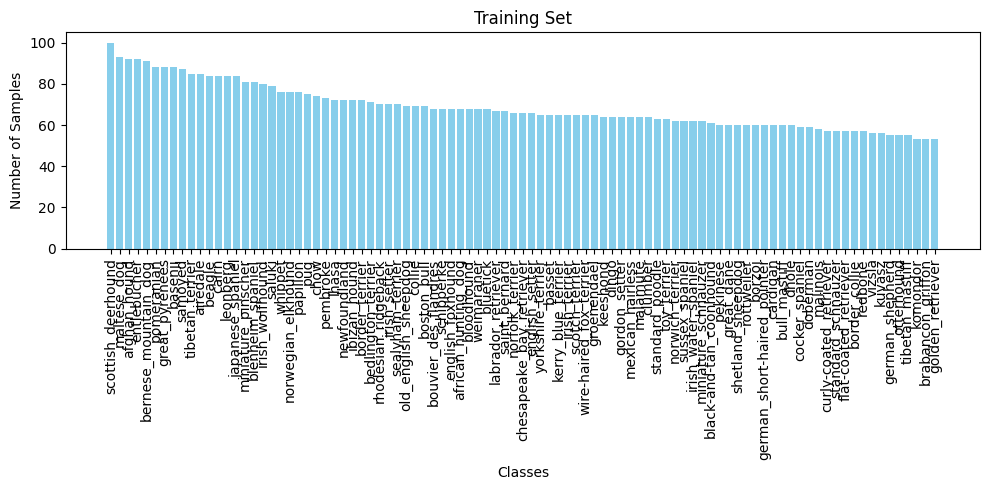


Validation Set Distribution:
cocker_spaniel: 7
saluki: 9
norwich_terrier: 7
bernese_mountain_dog: 11
keeshond: 8
curly-coated_retriever: 7
whippet: 9
beagle: 10
bouvier_des_flandres: 8
pekinese: 7
tibetan_terrier: 10
yorkshire_terrier: 8
old_english_sheepdog: 8
afghan_hound: 11
schipperke: 8
collie: 8
pomeranian: 11
standard_poodle: 7
great_dane: 7
basset: 8
english_foxhound: 8
miniature_pinscher: 10
bedlington_terrier: 8
boston_bull: 8
kerry_blue_terrier: 8
labrador_retriever: 8
dingo: 8
rhodesian_ridgeback: 8
sussex_spaniel: 7
maltese_dog: 11
norwegian_elkhound: 9
african_hunting_dog: 8
doberman: 7
vizsla: 7
lhasa: 9
shetland_sheepdog: 7
irish_setter: 8
newfoundland: 9
bloodhound: 8
german_shepherd: 6
weimaraner: 8
toy_terrier: 7
gordon_setter: 8
standard_schnauzer: 7
rottweiler: 7
borzoi: 7
irish_water_spaniel: 7
airedale: 10
cairn: 10
leonberg: 10
great_pyrenees: 11
flat-coated_retriever: 7
komondor: 6
irish_terrier: 8
mexican_hairless: 8
bluetick: 8
norfolk_terrier: 8
ibizan_houn

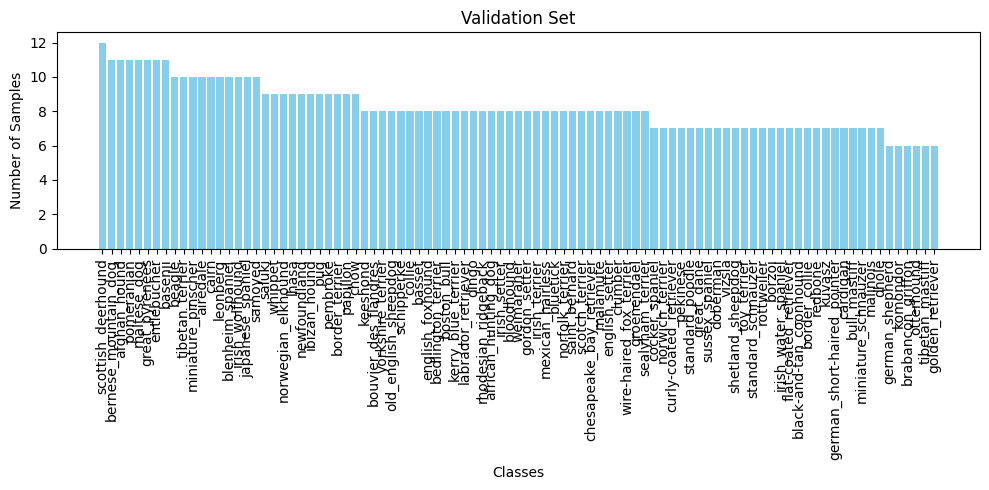


Test Set Distribution:
cocker_spaniel: 8
saluki: 11
norwich_terrier: 9
bernese_mountain_dog: 12
keeshond: 9
curly-coated_retriever: 8
whippet: 10
beagle: 11
bouvier_des_flandres: 10
pekinese: 8
tibetan_terrier: 12
yorkshire_terrier: 9
old_english_sheepdog: 10
afghan_hound: 13
schipperke: 10
collie: 10
pomeranian: 12
standard_poodle: 9
great_dane: 8
basset: 9
english_foxhound: 10
miniature_pinscher: 11
bedlington_terrier: 10
boston_bull: 10
kerry_blue_terrier: 9
labrador_retriever: 9
dingo: 8
rhodesian_ridgeback: 10
sussex_spaniel: 9
maltese_dog: 13
norwegian_elkhound: 10
african_hunting_dog: 10
doberman: 8
vizsla: 7
lhasa: 9
shetland_sheepdog: 9
irish_setter: 10
newfoundland: 10
bloodhound: 9
german_shepherd: 8
weimaraner: 9
toy_terrier: 9
gordon_setter: 9
standard_schnauzer: 8
rottweiler: 9
borzoi: 8
irish_water_spaniel: 9
airedale: 12
cairn: 12
leonberg: 12
great_pyrenees: 12
flat-coated_retriever: 8
komondor: 8
irish_terrier: 9
mexican_hairless: 8
bluetick: 9
norfolk_terrier: 9
ibi

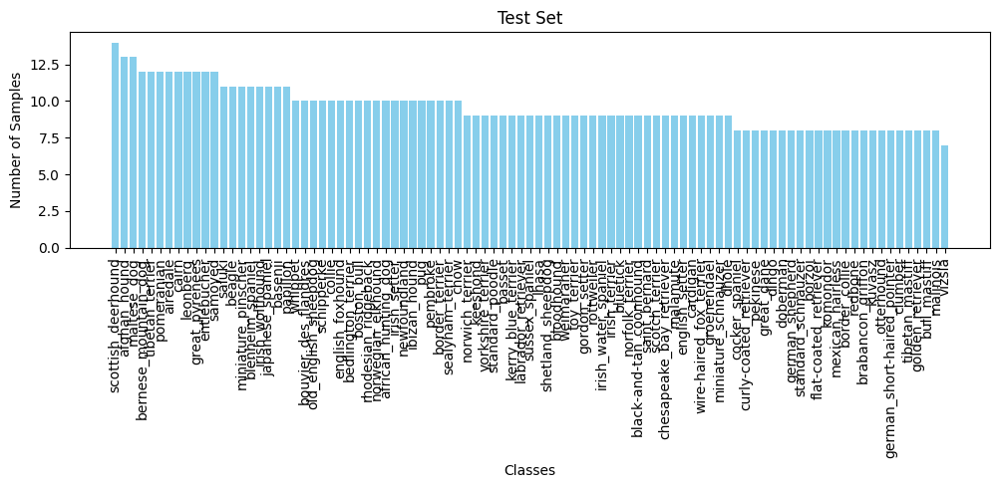

In [5]:
import os

def calculate_class_distribution(directory):
    class_counts = {}
    for class_folder in os.listdir(directory):
        class_path = os.path.join(directory, class_folder)
        if os.path.isdir(class_path):
            num_images = len(os.listdir(class_path))
            class_counts[class_folder] = num_images
    return class_counts

# Function to print and visualize the distribution
import matplotlib.pyplot as plt

def display_class_distribution(distribution, title):
    """Display class distribution as a bar chart."""
    print(f"\n{title} Distribution:")
    for cls, count in distribution.items():
        print(f"{cls}: {count}")

    sorted_distribution = sorted(distribution.items(), key=lambda x: x[1], reverse=True)
    classes, counts = zip(*sorted_distribution)

    # Plotting
    plt.figure(figsize=(10, 5))
    plt.bar(classes, counts, color='skyblue')
    plt.title(title)
    plt.xlabel("Classes")
    plt.ylabel("Number of Samples")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()

training_dir = "/kaggle/working/Dog Breed Classification/train"
validation_dir = "/kaggle/working/Dog Breed Classification/val"
test_dir = "/kaggle/working/Dog Breed Classification/test"

train_distribution = calculate_class_distribution(training_dir)
display_class_distribution(train_distribution, "Training Set")

validation_distribution = calculate_class_distribution(validation_dir)
display_class_distribution(validation_distribution, "Validation Set")

test_distribution = calculate_class_distribution(test_dir)
display_class_distribution(test_distribution, "Test Set")


In [6]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def prepare_dataset(directory, generator, target_size=(160, 160), batch_size=16, class_mode="sparse"):
    return generator.flow_from_directory(
        directory,
        target_size=target_size,
        batch_size=batch_size,
        class_mode=class_mode
    )

data_generator = ImageDataGenerator(
        rescale=1.0/255.0,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True
    )

train_set = prepare_dataset(training_dir, data_generator)
validation_set = prepare_dataset(validation_dir, data_generator)
test_set = prepare_dataset(test_dir, data_generator)

Found 6391 images belonging to 93 classes.
Found 762 images belonging to 93 classes.
Found 887 images belonging to 93 classes.


In [7]:
# Calculate the total number of samples for each dataset
train_total = sum(train_distribution.values())
validation_total = sum(validation_distribution.values())
test_total = sum(test_distribution.values())

# Calculate the total size of all datasets
total_samples = train_total + validation_total + test_total

# Print total size and percentage for each dataset
print(f"\nTotal size of the datasets:")
print(f"Training Set: {train_total} samples ({(train_total / total_samples) * 100:.2f}%)")
print(f"Validation Set: {validation_total} samples ({(validation_total / total_samples) * 100:.2f}%)")
print(f"Test Set: {test_total} samples ({(test_total / total_samples) * 100:.2f}%)")



Total size of the datasets:
Training Set: 6391 samples (79.49%)
Validation Set: 762 samples (9.48%)
Test Set: 887 samples (11.03%)


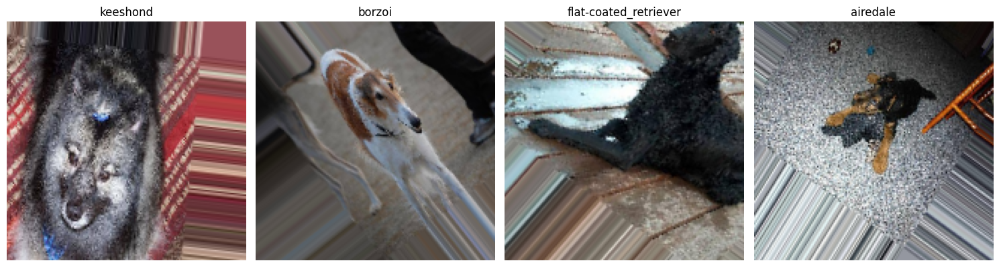

In [8]:
import matplotlib.pyplot as plt

def visualize_samples(images, labels, class_indices, num_samples=4):
    class_names = {v: k for k, v in class_indices.items()}  # Reverse mapping of class indices
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))

    for i in range(num_samples):
        axes[i].imshow(images[i]) 
        label_index = int(labels[i])
        class_name = class_names[label_index]
        axes[i].set_title(f"{class_name}")
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()


images, labels = next(train_set)
visualize_samples(images, labels, train_set.class_indices, num_samples=4)

In [9]:
import time
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import Xception
import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from keras import models
from keras import optimizers
from keras.models import Model, Sequential
from keras import layers

import tensorflow as tf

base_model = InceptionV3(weights='imagenet',
    include_top=False,
    input_shape=(160, 160, 3))

for layer in base_model.layers[:-10]:
    layer.trainable = False

model = Sequential()
model.add(base_model)
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(93, activation='softmax'))

model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001),
    metrics=['accuracy']
)
start_time = time.time()
fine_tune_inception_model_1 = model.fit(
    train_set,
    epochs=50,
    validation_data=validation_set,
    )
end_time = time.time()

training_time = end_time - start_time

print(f"Training time for 50 epochs: {training_time:.2f} seconds")

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


400/400 ━━━━━━━━━━━━━━━━━━━━ 74s 149ms/step - accuracy: 0.0650 - loss: 4.4009 - val_accuracy: 0.3123 - val_loss: 3.1249
Epoch 2/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 114ms/step - accuracy: 0.3029 - loss: 2.9746 - val_accuracy: 0.4055 - val_loss: 2.4041
Epoch 3/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 113ms/step - accuracy: 0.3889 - loss: 2.5666 - val_accuracy: 0.4541 - val_loss: 2.1977
Epoch 4/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 113ms/step - accuracy: 0.4139 - loss: 2.3752 - val_accuracy: 0.4501 - val_loss: 2.2415
Epoch 5/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 113ms/step - accuracy: 0.4531 - loss: 2.2344 - val_accuracy: 0.4606 - val_loss: 2.1894
Epoch 6/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 114ms/step - accuracy: 0.4669 - loss: 2.1591 - val_accuracy: 0.4764 - val_loss: 2.0663
Epoch 7/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 113ms/step - accuracy: 0.4584 - loss: 2.1859 - val_accuracy: 0.4803 - val_loss: 2.0793
Epoch 8/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 113ms/step - accuracy: 0.4746 - loss: 2.0831 - val

In [10]:
def show_plot(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(acc) + 1)
    
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    axs[0].plot(epochs, acc, label='Training Accuracy', linewidth=2, marker='o')
    axs[0].plot(epochs, val_acc, label='Validation Accuracy', linewidth=2, marker='o', linestyle='--')
    axs[0].set_title('Training vs Validation Accuracy', fontsize=14, fontweight='bold')
    axs[0].set_xlabel('Epochs', fontsize=12)
    axs[0].set_ylabel('Accuracy', fontsize=12)
    axs[0].legend(loc='best', fontsize=10)
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    axs[1].plot(epochs, loss, label='Training Loss', linewidth=2, marker='s')
    axs[1].plot(epochs, val_loss, label='Validation Loss', linewidth=2, marker='s', linestyle='--')
    axs[1].set_title('Training vs Validation Loss', fontsize=14, fontweight='bold')
    axs[1].set_xlabel('Epochs', fontsize=12)
    axs[1].set_ylabel('Loss', fontsize=12)
    axs[1].legend(loc='best', fontsize=10)
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout(pad=3.0)
    plt.show()

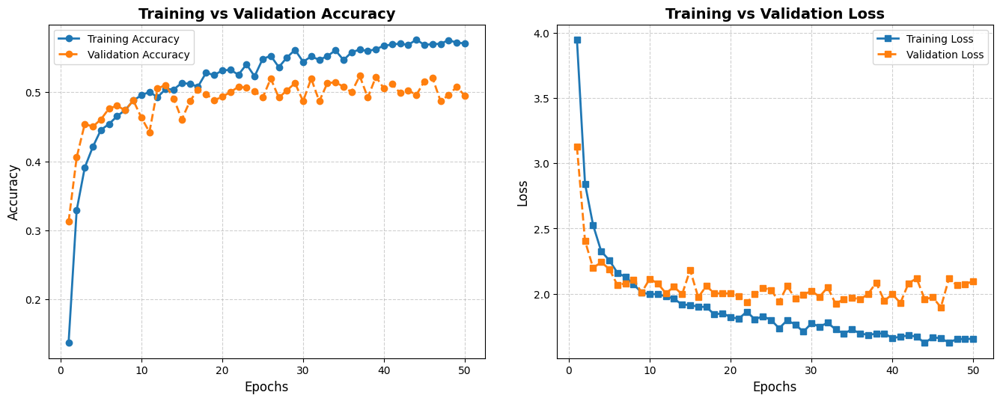

In [11]:
show_plot(fine_tune_inception_model_1)

In [12]:
model.save('dog_tune_inception_model_1.h5')

In [13]:
species_list = list(train_set.class_indices.keys())

species_list.sort()

print(species_list)

['afghan_hound', 'african_hunting_dog', 'airedale', 'basenji', 'basset', 'beagle', 'bedlington_terrier', 'bernese_mountain_dog', 'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound', 'bluetick', 'border_collie', 'border_terrier', 'borzoi', 'boston_bull', 'bouvier_des_flandres', 'brabancon_griffon', 'bull_mastiff', 'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chow', 'clumber', 'cocker_spaniel', 'collie', 'curly-coated_retriever', 'dhole', 'dingo', 'doberman', 'english_foxhound', 'english_setter', 'entlebucher', 'flat-coated_retriever', 'german_shepherd', 'german_short-haired_pointer', 'golden_retriever', 'gordon_setter', 'great_dane', 'great_pyrenees', 'groenendael', 'ibizan_hound', 'irish_setter', 'irish_terrier', 'irish_water_spaniel', 'irish_wolfhound', 'japanese_spaniel', 'keeshond', 'kerry_blue_terrier', 'komondor', 'kuvasz', 'labrador_retriever', 'leonberg', 'lhasa', 'malamute', 'malinois', 'maltese_dog', 'mexican_hairless', 'miniature_pinscher', 'miniature_schnauzer',

In [14]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ inception_v3 (Functional)            │ (None, 3, 3, 2048)          │      21,802,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 18432)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       2,359,424 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 93)                  │          23,901 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 26,635,676 (101.61 MB)

 Trainable params: 2,416,541 (9.22 MB)

 Non-trainable params: 21,802,592 (83.17 MB)

 Optimizer params: 2,416,543 (9.22 MB)

In [15]:
test_loss_inception, test_accuracy_inception = model.evaluate(test_set, steps=test_total // test_set.batch_size)
print(f"Test Loss: {test_loss_inception:.4f}")
print(f"Test Accuracy: {test_accuracy_inception:.4f}")

55/55 ━━━━━━━━━━━━━━━━━━━━ 6s 100ms/step - accuracy: 0.5443 - loss: 1.9862
Test Loss: 1.9375
Test Accuracy: 0.5352


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 21.5M/21.5M [00:00<00:00, 188MB/s]



0: 640x576 1 dog, 1 chair, 39.6ms
Speed: 18.7ms preprocess, 39.6ms inference, 264.1ms postprocess per image at shape (1, 3, 640, 576)
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
Image: https://dogsdigestblog.wordpress.com/wp-content/uploads/2020/02/img_5862.jpg
YOLO: dog (Confidence: 79.56%)
Classification: bluetick 99.65%, german_short-haired_pointer 0.34%
Expected breed: bluetick
Match with true label: Yes


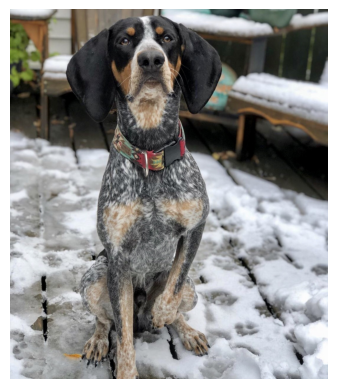


0: 480x640 1 dog, 39.5ms
Speed: 2.3ms preprocess, 39.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image: https://belgi.pl/wp-content/uploads/2023/06/labrador-gae6d1bdea_1280-1024x726.jpg
YOLO: dog (Confidence: 92.21%)
Classification: labrador_retriever 98.94%, great_dane 0.87%
Expected breed: labrador_retriever
Match with true label: Yes


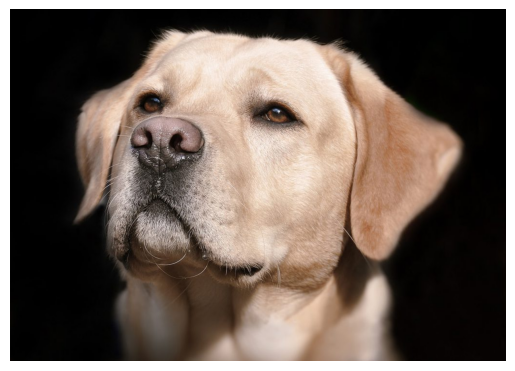


0: 448x640 1 dog, 39.7ms
Speed: 2.4ms preprocess, 39.7ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Image: https://cdn.britannica.com/31/258231-050-66145168/Old-English-Sheepdog-sitting-in-the-grass.jpg
YOLO: dog (Confidence: 91.54%)
Classification: old_english_sheepdog 86.65%, tibetan_terrier 13.00%
Expected breed: old_english_sheepdog
Match with true label: Yes


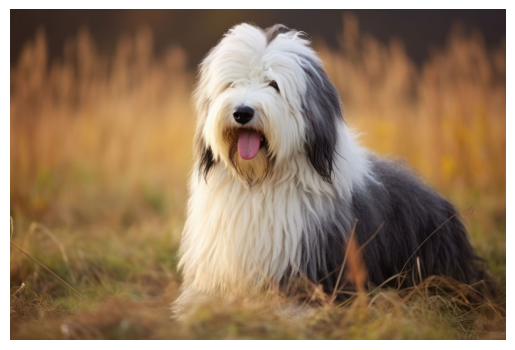


0: 448x640 2 dogs, 6.8ms
Speed: 2.8ms preprocess, 6.8ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://www.butcherspetcare.com/wp-content/uploads/2024/06/shutterstock_1792147286.jpg
YOLO: dog (Confidence: 80.84%)
Classification: yorkshire_terrier 99.81%, norfolk_terrier 0.05%
Expected breed: yorkshire_terrier
Match with true label: Yes


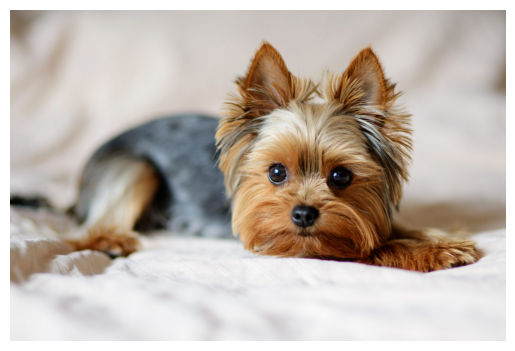


0: 448x640 1 dog, 6.9ms
Speed: 2.2ms preprocess, 6.9ms inference, 3.9ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image: https://media.istockphoto.com/id/1395878741/pl/zdj%C4%99cie/szkolenie-owczarka-belgijskiego.jpg?s=612x612&w=0&k=20&c=xZMC99fPa1IZEJ1YIzQrurgtRLv967QbVc6lTNUY0xQ=
YOLO: dog (Confidence: 90.59%)
Classification: malinois 97.62%, german_shepherd 2.16%
Expected breed: malinois
Match with true label: Yes


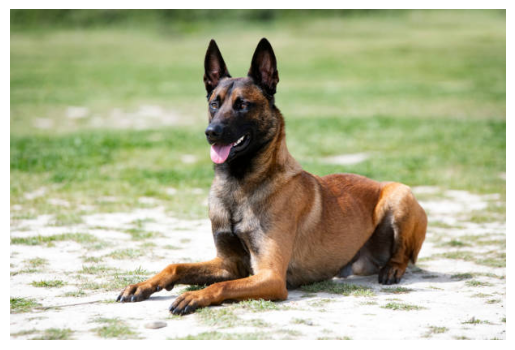

In [19]:
import cv2
import numpy as np
from ultralytics import YOLO
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import requests
from PIL import Image
from io import BytesIO

# Expected values for test images
true_breeds = ["bluetick", "labrador_retriever", "old_english_sheepdog", "yorkshire_terrier", "malinois"]

# Load YOLO detection model
yolo_model = YOLO("yolov8s.pt")

# Load classification model
classification_model = model  # Replace with your loaded model if needed

# Function to preprocess the image
def preprocess_image(image, target_size):
    img = cv2.resize(image, target_size)
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=0)
    return img

# Perform inference on the region of interest (ROI)
def classify_region(image, model, target_size=(160, 160), top_k=2):
    input_image = preprocess_image(image, target_size)
    predictions = model.predict(input_image)[0]
    top_indices = predictions.argsort()[-top_k:][::-1]
    top_predictions = [(species_list[idx], predictions[idx]) for idx in top_indices]
    return top_predictions

# Function to download the image from a URL
def download_image(image_url):
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    return np.array(img)

# Function to process a single image
def process_image(image_url, true_breed, model, yolo_model, species_list):
    # Download the image
    image = download_image(image_url)

    # Check if the image is loaded correctly
    if image is None or image.size == 0:
        print(f"Error: The image from {image_url} could not be loaded!")
        return

    # Perform YOLO inference
    results = yolo_model(image)
    detections = results[0].boxes

    detected_dog = False
    for detection in detections:
        x1, y1, x2, y2 = map(int, detection.xyxy[0].tolist())
        conf = float(detection.conf[0])
        cls_label = yolo_model.names[int(detection.cls[0])]

        # Check if the detected object is a dog
        if cls_label == "dog":
            detected_dog = True
            roi = image[y1:y2, x1:x2]

            # Classify the detected region
            if roi.shape[0] > 0 and roi.shape[1] > 0:
                predictions = classify_region(roi, model, top_k=2)
                label, confidence = predictions[0]
                second_label, second_confidence = predictions[1]

                # Compare with expected breed
                is_correct = label.lower() == true_breed.lower()

                # Display the result
                print(f"Image: {image_url}")
                print(f"YOLO: dog (Confidence: {conf*100:.2f}%)")
                print(f"Classification: {label} {confidence*100:.2f}%, {second_label} {second_confidence*100:.2f}%")
                print(f"Expected breed: {true_breed}")
                print(f"Match with true label: {'Yes' if is_correct else 'No'}")
                break

    # If no dog detected, still display the expected breed
    if not detected_dog:
        print(f"Image: {image_url}")
        print("No dog detected.")
        print(f"Expected breed: {true_breed}")

    # Display the image
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# List of image URLs and processing
image_urls = [
    "https://dogsdigestblog.wordpress.com/wp-content/uploads/2020/02/img_5862.jpg",
    "https://belgi.pl/wp-content/uploads/2023/06/labrador-gae6d1bdea_1280-1024x726.jpg",
    "https://cdn.britannica.com/31/258231-050-66145168/Old-English-Sheepdog-sitting-in-the-grass.jpg",
    "https://www.butcherspetcare.com/wp-content/uploads/2024/06/shutterstock_1792147286.jpg",
    "https://media.istockphoto.com/id/1395878741/pl/zdj%C4%99cie/szkolenie-owczarka-belgijskiego.jpg?s=612x612&w=0&k=20&c=xZMC99fPa1IZEJ1YIzQrurgtRLv967QbVc6lTNUY0xQ="
]

# Process all images
for i, image_url in enumerate(image_urls):
    expected_breed = true_breeds[i] if i < len(true_breeds) else "Unknown"
    process_image(image_url, expected_breed, classification_model, yolo_model, species_list)


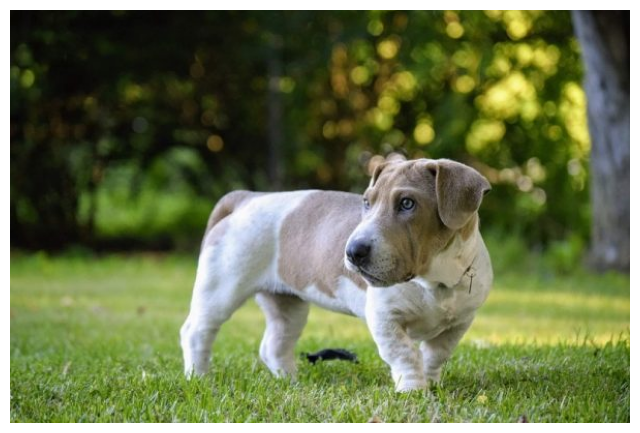


0: 448x640 1 dog, 6.8ms
Speed: 1.9ms preprocess, 6.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image: https://www.dogster.com/wp-content/uploads/2024/03/Ba-Shar-dog-on-grass_Enbrunner_Shutterstock-600x400.jpg
Top matches (with percentages): [('beagle', 24.79), ('english_foxhound', 17.23), ('german_short-haired_pointer', 14.44), ('labrador_retriever', 10.11), ('bluetick', 5.87)]


In [20]:
import cv2
import numpy as np
from ultralytics import YOLO
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import requests
from PIL import Image
from io import BytesIO

def check_crossbreed_match(image_url, model, yolo_model, species_list):
    # Download the image
    image = download_image(image_url)

    # Check if the image is loaded correctly
    if image is None or image.size == 0:
        print(f"Error: The image from {image_url} could not be loaded!")
        return

    # Perform YOLO inference
    results = yolo_model(image)
    detections = results[0].boxes

    detected_dog = False
    for detection in detections:
        x1, y1, x2, y2 = map(int, detection.xyxy[0].tolist())
        conf = float(detection.conf[0])
        cls_label = yolo_model.names[int(detection.cls[0])]

        # Check if the detected object is a dog
        if cls_label == "dog":
            detected_dog = True
            roi = image[y1:y2, x1:x2]

            # Classify the detected region
            if roi.shape[0] > 0 and roi.shape[1] > 0:
                predictions = classify_region(roi, model, top_k=5)
                top_labels = [(label, round(probability * 100, 2)) for label, probability in predictions]

                # Display percentages of each predicted breed
                print(f"Image: {image_url}")
                print(f"Top matches (with percentages): {top_labels}")


    # If no dog detected
    if not detected_dog:
        print(f"Image: {image_url}")
        print("No dog detected.")

def display_image_from_url(image_url):
    try:
        response = requests.get(image_url)
        response.raise_for_status()  # Raise HTTPError for bad responses
        img = Image.open(BytesIO(response.content))
        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        plt.axis('off')  # Hide axes
        plt.show()
    except Exception as e:
        print(f"Error displaying the image: {e}")


# Link to the A Bassador (Basset - Labrador Retriever cross) image
abassador_image_url = "https://www.dogster.com/wp-content/uploads/2024/03/Ba-Shar-dog-on-grass_Enbrunner_Shutterstock-600x400.jpg"  # Replace with the actual link to the crossbreed image
display_image_from_url(abassador_image_url)
# Process the A Bassador image
check_crossbreed_match(abassador_image_url, classification_model, yolo_model, species_list)

In [21]:
import time
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import ResNet50, MobileNetV2, EfficientNetB0
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.layers import Dropout
from keras import layers

import tensorflow as tf

# Load MobileNetV2 with pre-trained weights
mobilenet_base = MobileNetV2(weights="imagenet", include_top=False, input_shape=(160, 160, 3))

# Build the model
mobilenet_model = Sequential([
    mobilenet_base,
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.2),
    Dense(256, activation='relu'),
    Dense(93, activation='softmax')
])

# Compile the model
mobilenet_model.compile(
     optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)
start_time = time.time()

# Train the model
history_mobilenet = mobilenet_model.fit(
    train_set,
    validation_data=validation_set,
    epochs=50
)

# Record the end time
end_time = time.time()

# Calculate the total training time
training_time_mobilenet = end_time - start_time


# Save the model
mobilenet_model.save('dog_tune_mobilenetv2_model.h5')


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 111s 173ms/step - accuracy: 0.0597 - loss: 4.3603 - val_accuracy: 0.2402 - val_loss: 3.2454
Epoch 2/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 114ms/step - accuracy: 0.3179 - loss: 2.7342 - val_accuracy: 0.3885 - val_loss: 2.5132
Epoch 3/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.4359 - loss: 2.1616 - val_accuracy: 0.4672 - val_loss: 2.1754
Epoch 4/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.4995 - loss: 1.8900 - val_accuracy: 0.4711 - val_loss: 2.1533
Epoch 5/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.5441 - loss: 1.6384 - val_accuracy: 0.5472 - val_loss: 1.8276
Epoch 6/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.5787 - loss: 1.5082 - val_accuracy: 0.5499 - val_loss: 1.8792
Epoch 7/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 116ms/step - accuracy: 0.6078 - loss: 1.3947 - val_accuracy: 0.5538 - val_loss: 1.7260
Epoch 8/50
400/400 ━━━━━━━━━━━━━━

In [22]:
print(f"Training time for 50 epochs: {training_time_mobilenet:.2f} seconds")

Training time for 50 epochs: 2393.69 seconds


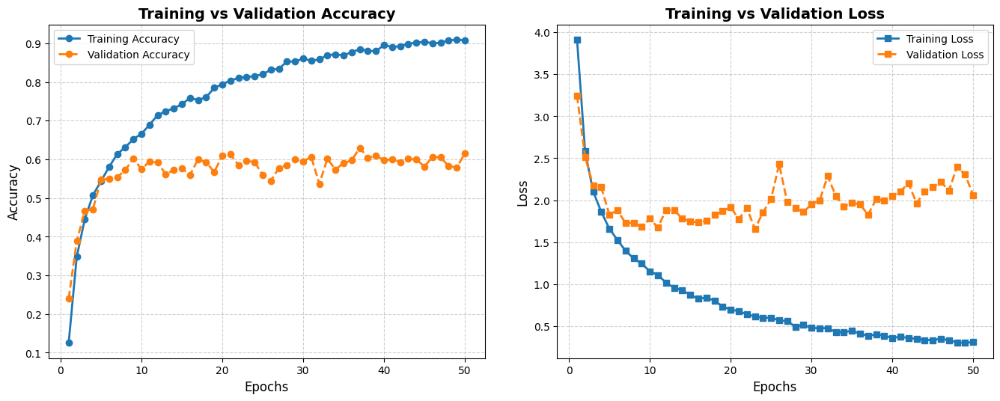

In [23]:
# Visualize the training performance
show_plot(history_mobilenet)

In [24]:
# Print the model summary
mobilenet_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_160 (Functional)    │ (None, 5, 5, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 32000)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 128)                 │       4,096,128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 93)                  │          23,901 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 19,164,889 (73.11 MB)

 Trainable params: 6,376,925 (24.33 MB)

 Non-trainable params: 34,112 (133.25 KB)

 Optimizer params: 12,753,852 (48.65 MB)

In [25]:
test_loss_mobilenet, test_accuracy_mobilenet = mobilenet_model.evaluate(test_set, steps=test_total // test_set.batch_size)
print(f"Test Loss: {test_loss_mobilenet:.4f}")
print(f"Test Accuracy: {test_accuracy_mobilenet:.4f}")

55/55 ━━━━━━━━━━━━━━━━━━━━ 6s 100ms/step - accuracy: 0.6540 - loss: 1.7548
Test Loss: 1.7754
Test Accuracy: 0.6534



0: 640x576 1 dog, 1 chair, 10.3ms
Speed: 3.6ms preprocess, 10.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 576)
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Image: https://dogsdigestblog.wordpress.com/wp-content/uploads/2020/02/img_5862.jpg
YOLO: dog (Confidence: 79.56%)
Classification: bluetick 100.00%, saluki 0.00%
Expected breed: bluetick
Match with true label: Yes


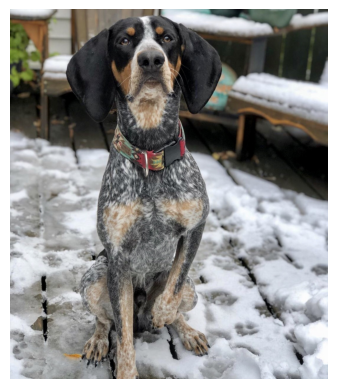


0: 480x640 1 dog, 7.5ms
Speed: 2.2ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Image: https://belgi.pl/wp-content/uploads/2023/06/labrador-gae6d1bdea_1280-1024x726.jpg
YOLO: dog (Confidence: 92.21%)
Classification: labrador_retriever 99.99%, golden_retriever 0.00%
Expected breed: labrador_retriever
Match with true label: Yes


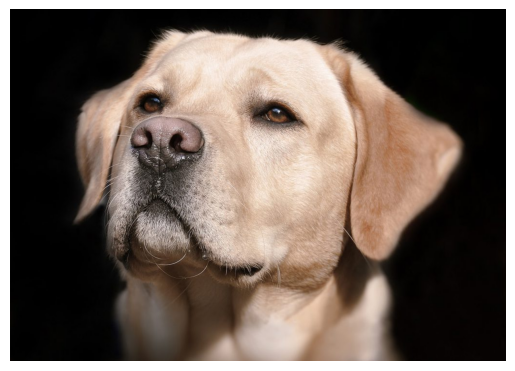


0: 448x640 1 dog, 7.5ms
Speed: 2.6ms preprocess, 7.5ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: https://cdn.britannica.com/31/258231-050-66145168/Old-English-Sheepdog-sitting-in-the-grass.jpg
YOLO: dog (Confidence: 91.54%)
Classification: tibetan_terrier 98.38%, old_english_sheepdog 1.62%
Expected breed: old_english_sheepdog
Match with true label: No


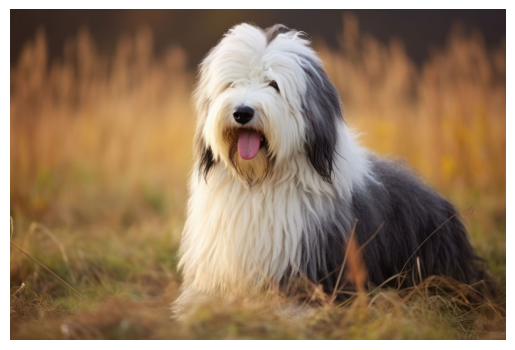


0: 448x640 2 dogs, 7.6ms
Speed: 2.6ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: https://www.butcherspetcare.com/wp-content/uploads/2024/06/shutterstock_1792147286.jpg
YOLO: dog (Confidence: 80.84%)
Classification: yorkshire_terrier 99.98%, norwich_terrier 0.01%
Expected breed: yorkshire_terrier
Match with true label: Yes


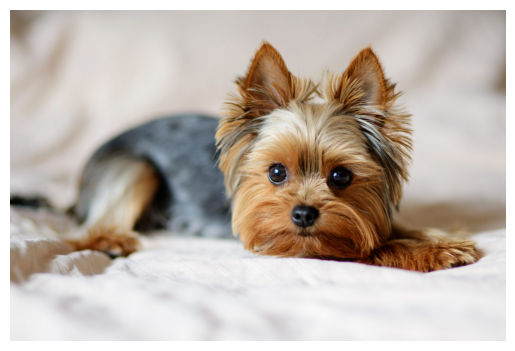


0: 448x640 1 dog, 6.9ms
Speed: 2.3ms preprocess, 6.9ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: https://media.istockphoto.com/id/1395878741/pl/zdj%C4%99cie/szkolenie-owczarka-belgijskiego.jpg?s=612x612&w=0&k=20&c=xZMC99fPa1IZEJ1YIzQrurgtRLv967QbVc6lTNUY0xQ=
YOLO: dog (Confidence: 90.59%)
Classification: malinois 99.09%, dingo 0.90%
Expected breed: malinois
Match with true label: Yes


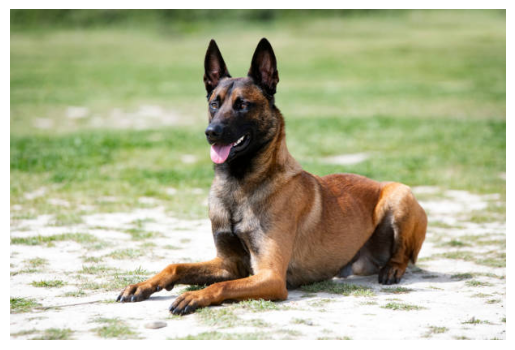

In [26]:
classification_model = mobilenet_model
for i, image_url in enumerate(image_urls):
    expected_breed = true_breeds[i] if i < len(true_breeds) else "Unknown"
    process_image(image_url, expected_breed, classification_model, yolo_model, species_list)

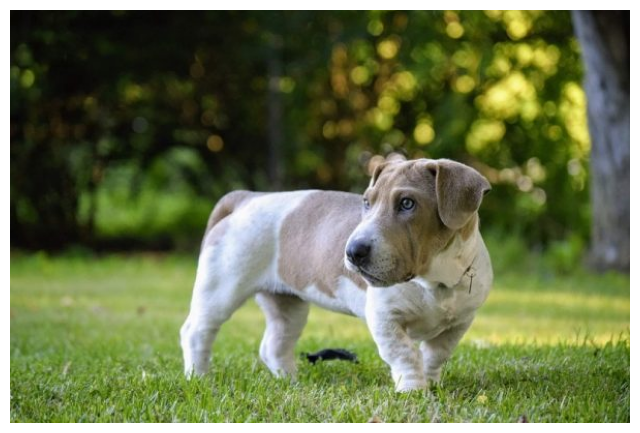


0: 448x640 1 dog, 6.8ms
Speed: 2.0ms preprocess, 6.8ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Image: https://www.dogster.com/wp-content/uploads/2024/03/Ba-Shar-dog-on-grass_Enbrunner_Shutterstock-600x400.jpg
Top matches (with percentages): [('english_foxhound', 45.3), ('beagle', 35.66), ('great_dane', 14.53), ('labrador_retriever', 2.96), ('whippet', 0.46)]


In [27]:
display_image_from_url(abassador_image_url)
check_crossbreed_match(abassador_image_url, classification_model, yolo_model, species_list)

In [28]:
import time
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
import tensorflow as tf

# Load Xception
dense_base = DenseNet121(
    weights="imagenet",
    include_top=False,
    input_shape=(160, 160, 3)
)

# Freeze all layers except the last 10
for layer in dense_base.layers[:-10]:
    layer.trainable = False

# Build the model
dense_model = Sequential([
    dense_base,
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.2),
    Dense(256, activation='relu'),
    Dense(93, activation='softmax')  # Adjust the number of classes to match your dataset
])

# Compile the model
dense_model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    metrics=['accuracy']
)

start_time = time.time()

# Train the model
fine_tune_dense_model = dense_model.fit(
    train_set,
    epochs=50,
    validation_data=validation_set
)

# Record the end time
end_time = time.time()

# Calculate the total training time
training_time_dense = end_time - start_time

# Save the model
dense_model.save('dog_tune_xception_model.h5')


29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 96s 179ms/step - accuracy: 0.0320 - loss: 4.5161 - val_accuracy: 0.2034 - val_loss: 3.4885
Epoch 2/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.1911 - loss: 3.4315 - val_accuracy: 0.3753 - val_loss: 2.4975
Epoch 3/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.2944 - loss: 2.7529 - val_accuracy: 0.4331 - val_loss: 2.1814
Epoch 4/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 46s 114ms/step - accuracy: 0.3645 - loss: 2.3918 - val_accuracy: 0.4738 - val_loss: 1.9790
Epoch 5/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.3930 - loss: 2.2762 - val_accuracy: 0.5210 - val_loss: 1.8313
Epoch 6/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 115ms/step - accuracy: 0.4025 - loss: 2.2219 - val_accuracy: 0.5131 - val_loss: 1.8376
Epoch 7/50
400/400 ━━━━━━━━━━━━━━━━━━━━ 47s 114ms/step - accuracy: 0.4408 - loss: 2.0731 - val_accuracy: 0.5013 - val_loss: 1.8275
Epoch 8/50
400/400 ━━━━━━━━━━━━━

In [29]:
print(f"Training time for 50 epochs: {training_time_dense:.2f} seconds")

Training time for 50 epochs: 2365.17 seconds


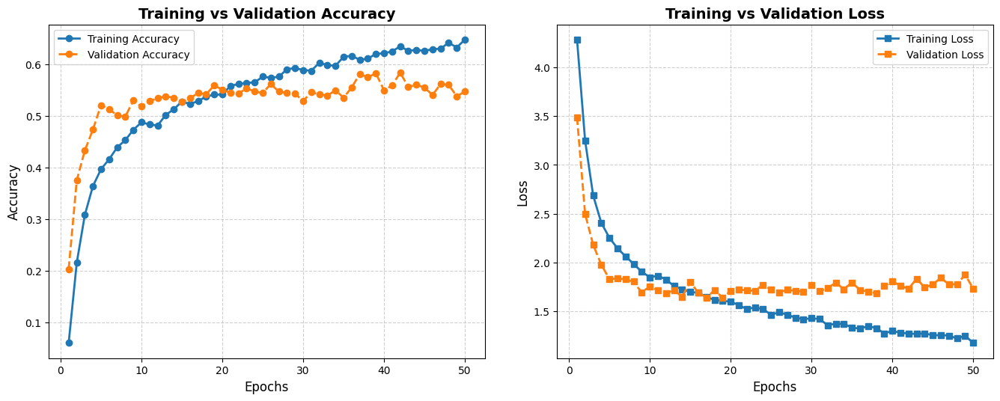

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ densenet121 (Functional)             │ (None, 5, 5, 1024)          │       7,037,504 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 25600)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 128)                 │       3,276,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 93)                  │          23,901 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 17,375,321 (66.28 MB)

 Trainable params: 3,501,981 (13.36 MB)

 Non-trainable params: 6,869,376 (26.20 MB)

 Optimizer params: 7,003,964 (26.72 MB)

In [30]:
# Visualize the training performance
show_plot(fine_tune_dense_model)

# Print the model summary
dense_model.summary()

In [31]:
test_loss_dense, test_accuracy_dense = dense_model.evaluate(test_set, steps=test_total // test_set.batch_size)
print(f"Test Loss: {test_loss_dense:.4f}")
print(f"Test Accuracy: {test_accuracy_dense:.4f}")

55/55 ━━━━━━━━━━━━━━━━━━━━ 6s 101ms/step - accuracy: 0.5568 - loss: 1.7474
Test Loss: 1.7128
Test Accuracy: 0.5614



0: 640x576 1 dog, 1 chair, 10.7ms
Speed: 4.3ms preprocess, 10.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 576)
1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step
Image: https://dogsdigestblog.wordpress.com/wp-content/uploads/2020/02/img_5862.jpg
YOLO: dog (Confidence: 79.56%)
Classification: bluetick 99.69%, entlebucher 0.18%
Expected breed: bluetick
Match with true label: Yes


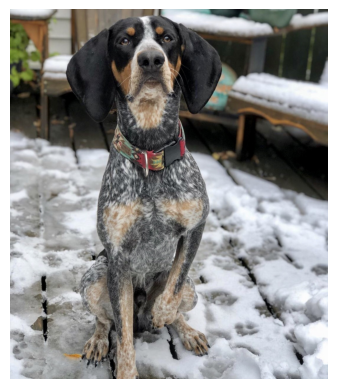


0: 480x640 1 dog, 7.9ms
Speed: 2.6ms preprocess, 7.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://belgi.pl/wp-content/uploads/2023/06/labrador-gae6d1bdea_1280-1024x726.jpg
YOLO: dog (Confidence: 92.21%)
Classification: labrador_retriever 96.72%, golden_retriever 1.10%
Expected breed: labrador_retriever
Match with true label: Yes


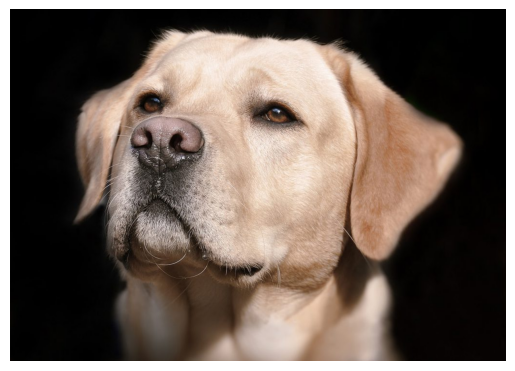


0: 448x640 1 dog, 7.9ms
Speed: 2.8ms preprocess, 7.9ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://cdn.britannica.com/31/258231-050-66145168/Old-English-Sheepdog-sitting-in-the-grass.jpg
YOLO: dog (Confidence: 91.54%)
Classification: tibetan_terrier 50.31%, old_english_sheepdog 45.91%
Expected breed: old_english_sheepdog
Match with true label: No


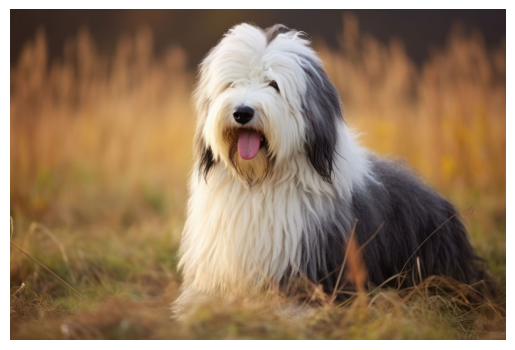


0: 448x640 2 dogs, 6.8ms
Speed: 2.6ms preprocess, 6.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://www.butcherspetcare.com/wp-content/uploads/2024/06/shutterstock_1792147286.jpg
YOLO: dog (Confidence: 80.84%)
Classification: yorkshire_terrier 99.98%, toy_terrier 0.01%
Expected breed: yorkshire_terrier
Match with true label: Yes


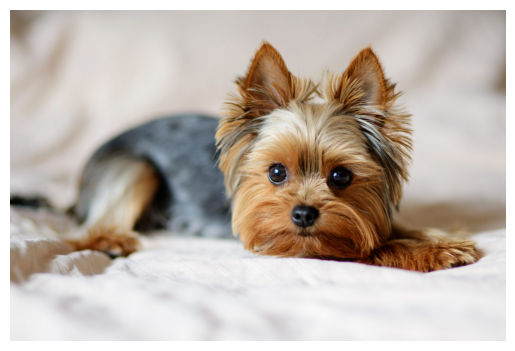


0: 448x640 1 dog, 6.9ms
Speed: 2.0ms preprocess, 6.9ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://media.istockphoto.com/id/1395878741/pl/zdj%C4%99cie/szkolenie-owczarka-belgijskiego.jpg?s=612x612&w=0&k=20&c=xZMC99fPa1IZEJ1YIzQrurgtRLv967QbVc6lTNUY0xQ=
YOLO: dog (Confidence: 90.59%)
Classification: malinois 92.91%, german_shepherd 7.08%
Expected breed: malinois
Match with true label: Yes


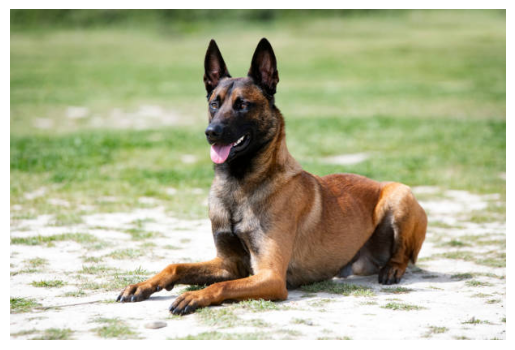

In [32]:
classification_model = dense_model
for i, image_url in enumerate(image_urls):
    expected_breed = true_breeds[i] if i < len(true_breeds) else "Unknown"
    process_image(image_url, expected_breed, classification_model, yolo_model, species_list)

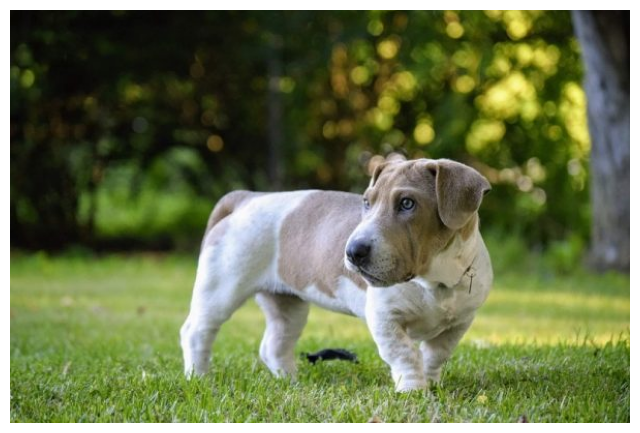


0: 448x640 1 dog, 6.8ms
Speed: 2.0ms preprocess, 6.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image: https://www.dogster.com/wp-content/uploads/2024/03/Ba-Shar-dog-on-grass_Enbrunner_Shutterstock-600x400.jpg
Top matches (with percentages): [('great_dane', 81.05), ('whippet', 8.08), ('weimaraner', 4.5), ('beagle', 2.59), ('labrador_retriever', 1.57)]


In [33]:
display_image_from_url(abassador_image_url)
check_crossbreed_match(abassador_image_url, classification_model, yolo_model, species_list)

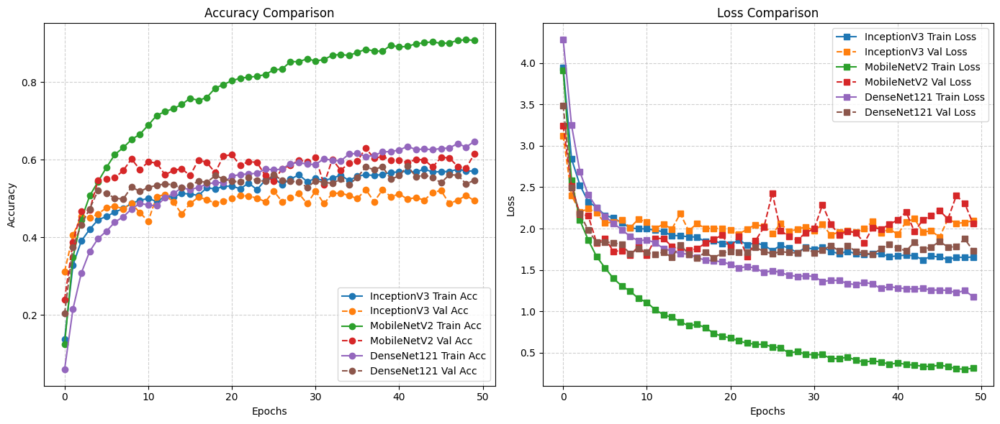

In [34]:
import matplotlib.pyplot as plt

# Function to compare training histories
def compare_training(histories, labels):
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    for history, label in zip(histories, labels):
        # Accuracy
        axs[0].plot(history.history['accuracy'], label=f"{label} Train Acc", marker='o')
        axs[0].plot(history.history['val_accuracy'], label=f"{label} Val Acc", linestyle='--', marker='o')
        
        # Loss
        axs[1].plot(history.history['loss'], label=f"{label} Train Loss", marker='s')
        axs[1].plot(history.history['val_loss'], label=f"{label} Val Loss", linestyle='--', marker='s')
    
    # Accuracy plot
    axs[0].set_title('Accuracy Comparison')
    axs[0].set_xlabel('Epochs')
    axs[0].set_ylabel('Accuracy')
    axs[0].legend()
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    # Loss plot
    axs[1].set_title('Loss Comparison')
    axs[1].set_xlabel('Epochs')
    axs[1].set_ylabel('Loss')
    axs[1].legend()
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout()
    plt.show()

# Histories of the models
histories = [fine_tune_inception_model_1, history_mobilenet, fine_tune_dense_model]
labels = ['InceptionV3', 'MobileNetV2', 'DenseNet121']

compare_training(histories, labels)


In [2]:
!git clone https://github.com/Horea94/Fruit-Images-Dataset.git fruits360

import os
print("Main directory:")
print(os.listdir("fruits360"))

Cloning into 'fruits360'...
remote: Enumerating objects: 385858, done.
remote: Counting objects: 100% (8693/8693), done.
remote: Compressing objects: 100% (8659/8659), done.
remote: Total 385858 (delta 37), reused 8688 (delta 34), pack-reused 377165 (from 1)
Receiving objects: 100% (385858/385858), 2.10 GiB | 46.38 MiB/s, done.
Resolving deltas: 100% (1197/1197), done.
Updating files: 100% (90503/90503), done.
Main directory:
['readme.md', 'LICENSE', 'src', 'papers', 'Test', '.git', 'Training', 'test-multiple_fruits']


In [3]:
import os
from PIL import Image

def check_dataset_integrity(base_dir):
    print(f"Checking folders in: {base_dir}")
    corrupted_files = []
    total_files = 0
    valid_files = 0

    for root, dirs, files in os.walk(base_dir):
        for file_name in files:
            file_path = os.path.join(root, file_name)
            total_files += 1
            try:
                with Image.open(file_path) as img:
                    img.verify()
                valid_files += 1
            except (IOError, SyntaxError) as e:
                corrupted_files.append(file_path)
                print(f"Corrupted file: {file_path} - {e}")

    print("\nSummary:")
    print(f"Total number of files: {total_files}")
    print(f"Valid files: {valid_files}")
    print(f"Corrupted files: {len(corrupted_files)}")

    if corrupted_files:
        print("\nList of corrupted files:")
        for file in corrupted_files:
            print(file)

    return corrupted_files

train_dir = "fruits360/Training"
corrupted_train_files = check_dataset_integrity(train_dir)
test_dir = "fruits360/Test"
corrupted_test_files = check_dataset_integrity(test_dir)

Checking folders in: fruits360/Training

Summary:
Total number of files: 67692
Valid files: 67692
Corrupted files: 0
Checking folders in: fruits360/Test

Summary:
Total number of files: 22688
Valid files: 22688
Corrupted files: 0


In [4]:
import os

def remove_corrupted_files(file_list):
    for file_path in file_list:
        try:
            os.remove(file_path)
            print(f"Removed: {file_path}")
        except Exception as e:
            print(f"Failed to remove {file_path}: {e}")

remove_corrupted_files(corrupted_train_files)

remove_corrupted_files(corrupted_test_files)


In [5]:
from tensorflow.keras.utils import image_dataset_from_directory

# Ścieżki do danych
train_dir = "fruits360/Training"
test_dir = "fruits360/Test"

# Wczytanie zestawu treningowego
train_dataset = image_dataset_from_directory(
    train_dir,
    labels="inferred",
    label_mode="int",
    image_size=(96, 96),  # Dopasuj rozmiar obrazów
    batch_size=32,
    validation_split=0.2,  # 20% for validation
    subset="training",
    seed=123
)

validation_dataset = image_dataset_from_directory(
    train_dir,
    labels="inferred",
    label_mode="int",
    image_size=(96, 96),
    batch_size=32,
    validation_split=0.2,  # 20% for validation
    subset="validation",
    seed=123
)

# Wczytanie zestawu testowego
test_dataset = image_dataset_from_directory(
    test_dir,
    labels="inferred",
    label_mode="int",
    image_size=(96, 96),
    batch_size=32
)

# Wyświetlenie przykładowych danych
for images, labels in train_dataset.take(1):
    print(f"Image shapes: {images.shape}")
    print(f"Labels: {labels.numpy()}")


Found 67692 files belonging to 131 classes.
Using 54154 files for training.
Found 67692 files belonging to 131 classes.
Using 13538 files for validation.
Found 22688 files belonging to 131 classes.
Image shapes: (32, 96, 96, 3)
Labels: [105 108  25 104  53  97   5  49  30 116  86  94  63  73 100  49 112  32
 105  95  13  61  46  15  54  50  25  89  28  25 114 114]



Training Set Distribution:
Apple Braeburn: 391
Apple Crimson Snow: 357
Apple Golden 1: 388
Apple Golden 2: 379
Apple Golden 3: 381
Apple Granny Smith: 400
Apple Pink Lady: 364
Apple Red 1: 396
Apple Red 2: 388
Apple Red 3: 345
Apple Red Delicious: 396
Apple Red Yellow 1: 387
Apple Red Yellow 2: 552
Apricot: 387
Avocado: 336
Avocado ripe: 390
Banana: 406
Banana Lady Finger: 354
Banana Red: 388
Beetroot: 361
Blueberry: 351
Cactus fruit: 390
Cantaloupe 1: 409
Cantaloupe 2: 395
Carambula: 388
Cauliflower: 564
Cherry 1: 402
Cherry 2: 580
Cherry Rainier: 586
Cherry Wax Black: 378
Cherry Wax Red: 381
Cherry Wax Yellow: 404
Chestnut: 364
Clementine: 385
Cocos: 377
Corn: 361
Corn Husk: 359
Cucumber Ripe: 326
Cucumber Ripe 2: 379
Dates: 374
Eggplant: 381
Fig: 572
Ginger Root: 232
Granadilla: 406
Grape Blue: 779
Grape Pink: 406
Grape White: 401
Grape White 2: 407
Grape White 3: 414
Grape White 4: 375
Grapefruit Pink: 400
Grapefruit White: 400
Guava: 393
Hazelnut: 368
Huckleberry: 390
Kaki: 393
K

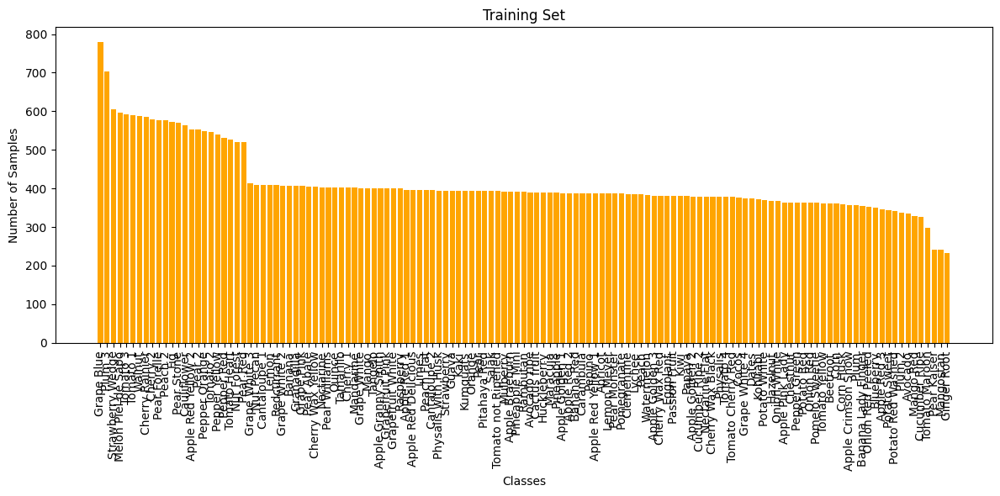


Validation Set Distribution:
Apple Braeburn: 101
Apple Crimson Snow: 87
Apple Golden 1: 92
Apple Golden 2: 113
Apple Golden 3: 100
Apple Granny Smith: 92
Apple Pink Lady: 92
Apple Red 1: 96
Apple Red 2: 104
Apple Red 3: 84
Apple Red Delicious: 94
Apple Red Yellow 1: 105
Apple Red Yellow 2: 120
Apricot: 105
Avocado: 91
Avocado ripe: 101
Banana: 84
Banana Lady Finger: 96
Banana Red: 102
Beetroot: 89
Blueberry: 111
Cactus fruit: 100
Cantaloupe 1: 83
Cantaloupe 2: 97
Carambula: 102
Cauliflower: 138
Cherry 1: 90
Cherry 2: 158
Cherry Rainier: 152
Cherry Wax Black: 114
Cherry Wax Red: 111
Cherry Wax Yellow: 88
Chestnut: 86
Clementine: 105
Cocos: 113
Corn: 89
Corn Husk: 103
Cucumber Ripe: 66
Cucumber Ripe 2: 89
Dates: 116
Eggplant: 87
Fig: 130
Ginger Root: 65
Granadilla: 84
Grape Blue: 205
Grape Pink: 86
Grape White: 89
Grape White 2: 83
Grape White 3: 78
Grape White 4: 96
Grapefruit Pink: 90
Grapefruit White: 92
Guava: 97
Hazelnut: 96
Huckleberry: 100
Kaki: 97
Kiwi: 86
Kohlrabi: 100
Kumquats

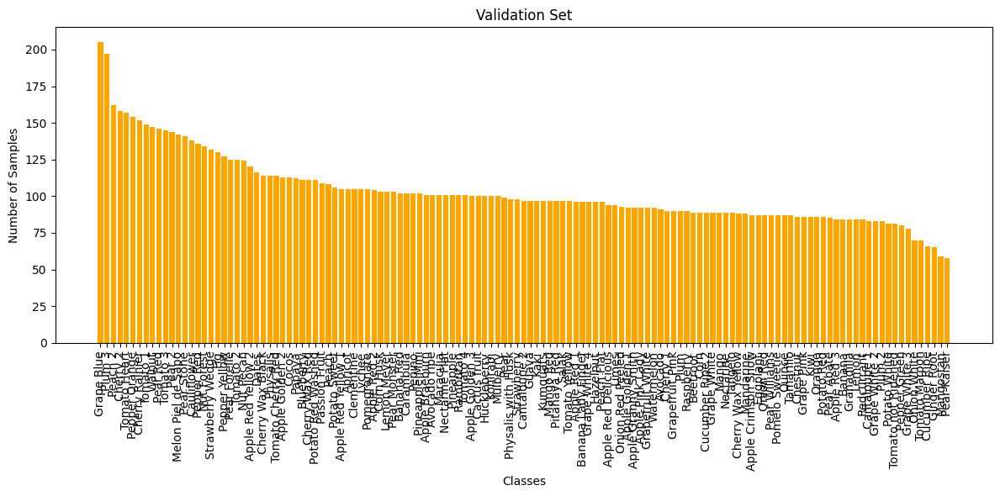


Test Set Distribution:
Cherry Rainier: 246
Potato Sweet: 150
Clementine: 166
Apple Golden 1: 160
Pineapple: 166
Papaya: 164
Nut Forest: 218
Granadilla: 166
Cherry Wax Black: 164
Watermelon: 157
Chestnut: 153
Avocado: 143
Beetroot: 150
Dates: 166
Onion Red: 150
Tomato not Ripened: 158
Orange: 160
Cantaloupe 2: 164
Corn: 150
Corn Husk: 154
Apple Red 1: 164
Banana Red: 166
Mulberry: 164
Eggplant: 156
Grapefruit Pink: 166
Grape White 2: 166
Pepper Green: 148
Avocado ripe: 166
Cherry 2: 246
Grape Pink: 164
Apricot: 164
Kaki: 166
Tomato 3: 246
Tomato Yellow: 153
Nut Pecan: 178
Pineapple Mini: 163
Pear 2: 232
Apple Red Yellow 2: 219
Ginger Root: 99
Lychee: 166
Strawberry: 164
Limes: 166
Grapefruit White: 164
Apple Red 2: 164
Grape White 4: 158
Grape White 3: 164
Pear: 164
Apple Red 3: 144
Pear Williams: 166
Passion Fruit: 166
Walnut: 249
Pomelo Sweetie: 153
Cherry Wax Red: 164
Apple Crimson Snow: 148
Apple Golden 2: 164
Kumquats: 166
Pear Stone: 237
Fig: 234
Potato White: 150
Cherry 1: 164
P

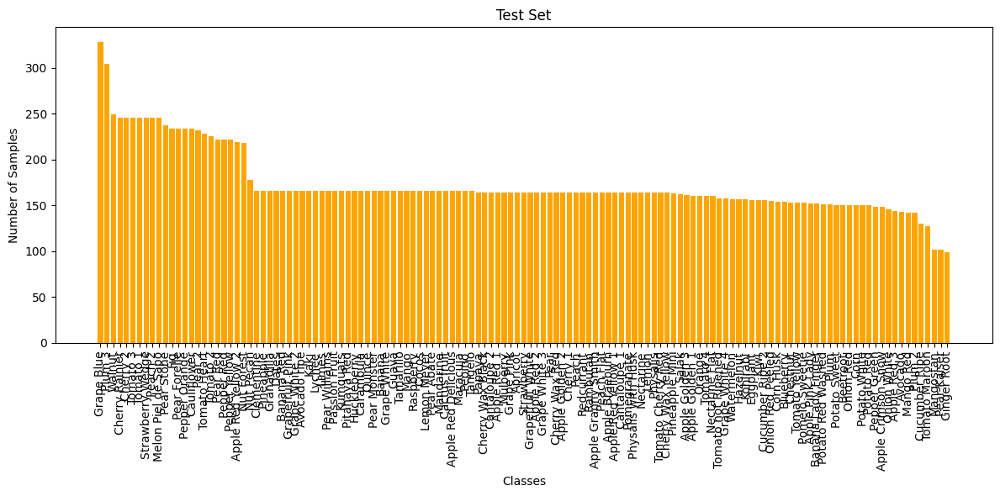

In [6]:
import os
import matplotlib.pyplot as plt

def calculate_class_distribution_from_dataset(dataset, class_names):
    """
    Calculate the distribution of classes from a TensorFlow dataset.
    """
    class_counts = {class_name: 0 for class_name in class_names}
    for _, labels in dataset:
        for label in labels.numpy():
            class_counts[class_names[label]] += 1
    return class_counts

def calculate_class_distribution(directory):
    """
    Calculate the distribution of classes in a given directory.
    """
    class_counts = {}
    for class_folder in os.listdir(directory):
        class_path = os.path.join(directory, class_folder)
        if os.path.isdir(class_path):
            num_images = len(os.listdir(class_path))
            class_counts[class_folder] = num_images
    return class_counts

def display_class_distribution(distribution, title):
    """
    Display class distribution as a bar chart.
    """
    print(f"\n{title} Distribution:")
    for cls, count in distribution.items():
        print(f"{cls}: {count}")

    sorted_distribution = sorted(distribution.items(), key=lambda x: x[1], reverse=True)
    classes, counts = zip(*sorted_distribution)

    # Plotting
    plt.figure(figsize=(12, 6))
    plt.bar(classes, counts, color='orange')
    plt.title(title)
    plt.xlabel("Classes")
    plt.ylabel("Number of Samples")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()


# Calculate distributions for training, validation, and test sets
class_names = train_dataset.class_names


train_distribution = calculate_class_distribution_from_dataset(train_dataset, class_names)
display_class_distribution(train_distribution, "Training Set")

validation_distribution = calculate_class_distribution_from_dataset(validation_dataset, class_names)
display_class_distribution(validation_distribution, "Validation Set")

test_distribution = calculate_class_distribution(test_dir)  # Use the function for directory-based calculation
display_class_distribution(test_distribution, "Test Set")


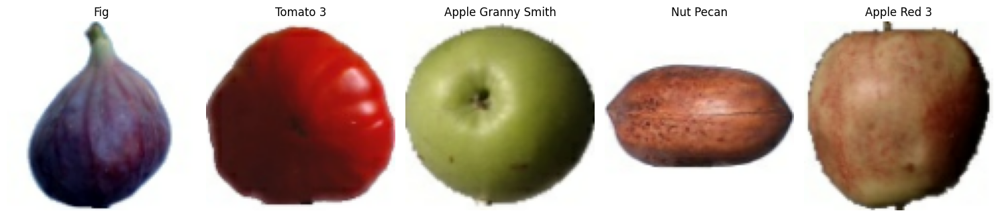

In [8]:
import matplotlib.pyplot as plt

def visualize_samples(dataset, class_names, num_samples=5):
    plt.figure(figsize=(15, 10))
    for images, labels in dataset.take(1):
        for i in range(num_samples):
            plt.subplot(1, num_samples, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(class_names[labels[i]])
            plt.axis("off")
    plt.tight_layout()
    plt.show()

class_names = train_dataset.class_names

visualize_samples(train_dataset, class_names)


In [9]:
for images, labels in train_dataset.take(1):
    print(f"Batch shape: {images.shape}, Labels shape: {labels.shape}")

Batch shape: (32, 96, 96, 3), Labels shape: (32,)


In [10]:
import tensorflow as tf

# Normalizacja danych
def preprocess(image, label):
    image = tf.cast(image, tf.float32) / 255.0  # Normalizacja obrazów do zakresu [0, 1]
    return image, label

# Mapowanie i optymalizacja
train_dataset = train_dataset.map(preprocess).cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
validation_dataset = validation_dataset.map(preprocess).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_dataset = test_dataset.map(preprocess).cache().prefetch(buffer_size=tf.data.AUTOTUNE)


In [11]:
print(class_names)

['Apple Braeburn', 'Apple Crimson Snow', 'Apple Golden 1', 'Apple Golden 2', 'Apple Golden 3', 'Apple Granny Smith', 'Apple Pink Lady', 'Apple Red 1', 'Apple Red 2', 'Apple Red 3', 'Apple Red Delicious', 'Apple Red Yellow 1', 'Apple Red Yellow 2', 'Apricot', 'Avocado', 'Avocado ripe', 'Banana', 'Banana Lady Finger', 'Banana Red', 'Beetroot', 'Blueberry', 'Cactus fruit', 'Cantaloupe 1', 'Cantaloupe 2', 'Carambula', 'Cauliflower', 'Cherry 1', 'Cherry 2', 'Cherry Rainier', 'Cherry Wax Black', 'Cherry Wax Red', 'Cherry Wax Yellow', 'Chestnut', 'Clementine', 'Cocos', 'Corn', 'Corn Husk', 'Cucumber Ripe', 'Cucumber Ripe 2', 'Dates', 'Eggplant', 'Fig', 'Ginger Root', 'Granadilla', 'Grape Blue', 'Grape Pink', 'Grape White', 'Grape White 2', 'Grape White 3', 'Grape White 4', 'Grapefruit Pink', 'Grapefruit White', 'Guava', 'Hazelnut', 'Huckleberry', 'Kaki', 'Kiwi', 'Kohlrabi', 'Kumquats', 'Lemon', 'Lemon Meyer', 'Limes', 'Lychee', 'Mandarine', 'Mango', 'Mango Red', 'Mangostan', 'Maracuja', 'Melo

In [12]:
import time
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten

# Load the InceptionV3 base model
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(96, 96, 3))

# Freeze the base model layers
base_model.trainable = False

# Build the full model
model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(len(class_names), activation='softmax')
])

# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [13]:
start_time = time.time()
history = model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=15
)
end_time = time.time()
training_time = end_time - start_time
print(f"Training time for 15 epochs: {training_time:.2f} seconds")

Epoch 1/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 71s 30ms/step - accuracy: 0.4747 - loss: 2.2426 - val_accuracy: 0.9455 - val_loss: 0.2264
Epoch 2/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.8352 - loss: 0.5307 - val_accuracy: 0.9653 - val_loss: 0.1300
Epoch 3/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.8701 - loss: 0.3963 - val_accuracy: 0.9741 - val_loss: 0.0902
Epoch 4/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.8846 - loss: 0.3558 - val_accuracy: 0.9798 - val_loss: 0.0680
Epoch 5/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.8997 - loss: 0.3104 - val_accuracy: 0.9862 - val_loss: 0.0530
Epoch 6/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.9039 - loss: 0.3033 - val_accuracy: 0.9837 - val_loss: 0.0568
Epoch 7/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.9080 - loss: 0.2876 - val_accuracy: 0.9892 - val_loss: 0.0386
Epoch 8/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 33s 19ms/step - accuracy: 0.9137 -

In [14]:
# Evaluate the model on the test dataset
test_loss, test_accuracy = model.evaluate(test_dataset)

# Print the test accuracy
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

709/709 ━━━━━━━━━━━━━━━━━━━━ 17s 24ms/step - accuracy: 0.8833 - loss: 0.7015
Test Accuracy: 87.97%


In [15]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ inception_v3 (Functional)            │ (None, 1, 1, 2048)          │      21,802,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 2048)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 2048)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 131)                 │          16,899 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 22,640,299 (86.37 MB)

 Trainable params: 279,171 (1.06 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

 Optimizer params: 558,344 (2.13 MB)

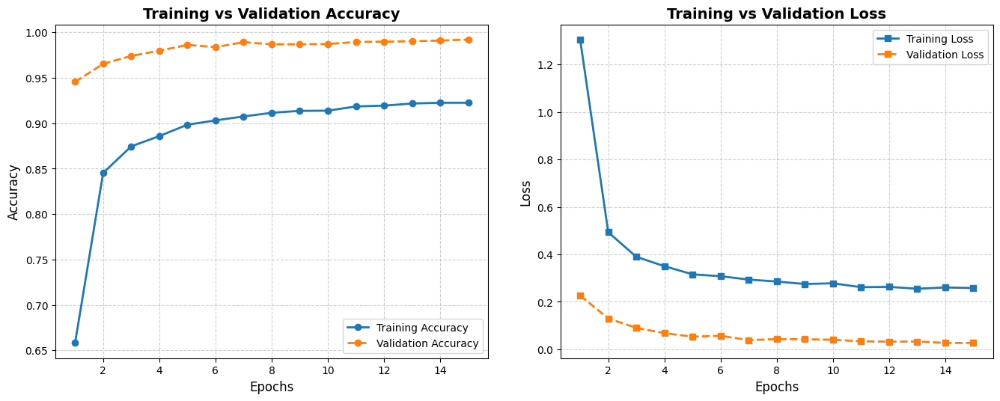

In [16]:
def show_plot(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(acc) + 1)
    
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    axs[0].plot(epochs, acc, label='Training Accuracy', linewidth=2, marker='o')
    axs[0].plot(epochs, val_acc, label='Validation Accuracy', linewidth=2, marker='o', linestyle='--')
    axs[0].set_title('Training vs Validation Accuracy', fontsize=14, fontweight='bold')
    axs[0].set_xlabel('Epochs', fontsize=12)
    axs[0].set_ylabel('Accuracy', fontsize=12)
    axs[0].legend(loc='best', fontsize=10)
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    # Plot Loss
    axs[1].plot(epochs, loss, label='Training Loss', linewidth=2, marker='s')
    axs[1].plot(epochs, val_loss, label='Validation Loss', linewidth=2, marker='s', linestyle='--')
    axs[1].set_title('Training vs Validation Loss', fontsize=14, fontweight='bold')
    axs[1].set_xlabel('Epochs', fontsize=12)
    axs[1].set_ylabel('Loss', fontsize=12)
    axs[1].legend(loc='best', fontsize=10)
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout(pad=3.0)
    plt.show()

show_plot(history)

Processing index 0: https://t4.ftcdn.net/jpg/05/35/26/95/360_F_535269565_W3ScF93L74MHNxgreu1KREMRwE2SHbOQ.jpg (True Label: Raspberry)

0: 544x640 (no detections), 8.3ms
Speed: 2.0ms preprocess, 8.3ms inference, 0.5ms postprocess per image at shape (1, 3, 544, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Classification (entire image): Raspberry 99.96%, Strawberry Wedge 0.04%
Match with true label (Raspberry): Yes


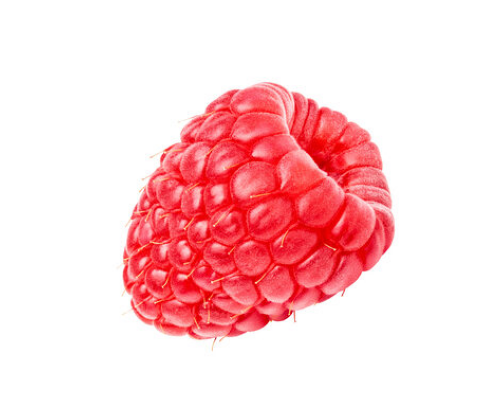

Processing index 1: https://images.albertsons-media.com/is/image/ABS/184110201?$ng-ecom-pdp-mobile$&defaultImage=Not_Available (True Label: Cantaloupe 1)

0: 640x640 (no detections), 9.3ms
Speed: 2.5ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Classification (entire image): Cantaloupe 1 100.00%, Cantaloupe 2 0.00%
Match with true label (Cantaloupe 1): Yes


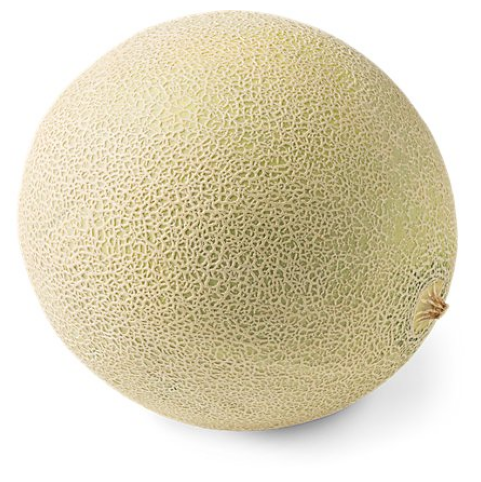

Processing index 2: https://media.istockphoto.com/id/177726303/photo/fresh-green-lime-isolated.jpg?s=612x612&w=0&k=20&c=KSIL64_zMFioesf2zZz7pF5GIm_lNLwdusJHoOf7a-0= (True Label: Limes)

0: 512x640 1 orange, 8.3ms
Speed: 2.5ms preprocess, 8.3ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
YOLO: orange (Confidence: 85.86%)
Classification: Mandarine 98.90%, Pomelo Sweetie 1.09%
Match with true label (Limes): No


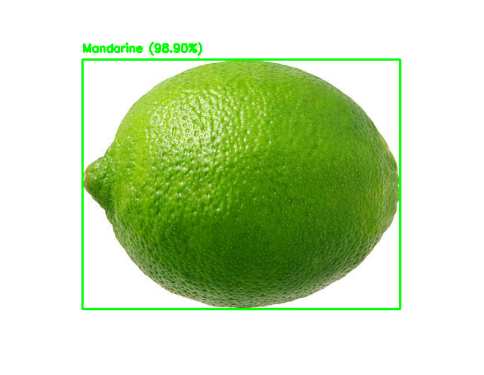

Processing index 3: https://amsterdam.co.nz/cdn/shop/products/pear.jpg?v=1620965886 (True Label: Pear 2)

0: 640x640 1 apple, 9.4ms
Speed: 3.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
YOLO: apple (Confidence: 37.94%)
Classification: Granadilla 54.17%, Pear 2 43.59%
Match with true label (Pear 2): No


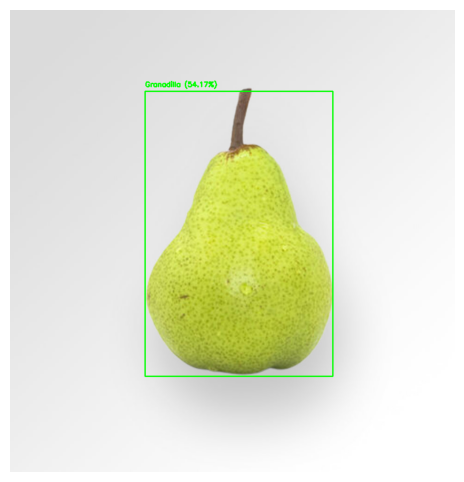

Processing index 4: https://img.freepik.com/free-photo/fresh-corn_1339-506.jpg (True Label: Corn)

0: 448x640 1 bowl, 7.5ms
Speed: 2.0ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
YOLO: bowl (Confidence: 47.73%)
Classification: Corn 98.35%, Physalis with Husk 1.52%
Match with true label (Corn): Yes


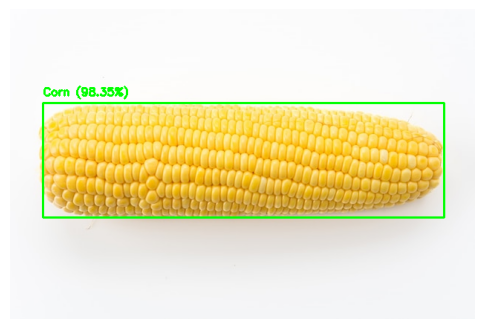

Processing index 5: https://www.kroger.com/product/images/xlarge/back/0000000004062 (True Label: Cucumber Ripe)

0: 416x640 1 knife, 7.8ms
Speed: 2.2ms preprocess, 7.8ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
YOLO: knife (Confidence: 51.22%)
Classification: Banana 100.00%, Corn 0.00%
Match with true label (Cucumber Ripe): No


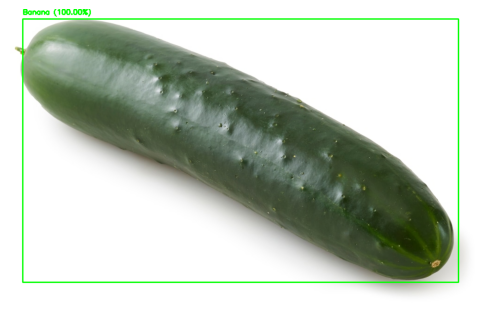

Processing index 6: https://images.rawpixel.com/image_800/cHJpdmF0ZS9sci9pbWFnZXMvd2Vic2l0ZS8yMDIyLTA1L2Zyc3RyYXdiZXJyeV9yZWRfZGVsaWNpb3VzX3N3ZWV0LWltYWdlLWt5YmNtM3c3LmpwZw.jpg (True Label: Strawberry Wedge)

0: 448x640 (no detections), 8.4ms
Speed: 2.4ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Classification (entire image): Strawberry Wedge 99.99%, Raspberry 0.01%
Match with true label (Strawberry Wedge): Yes


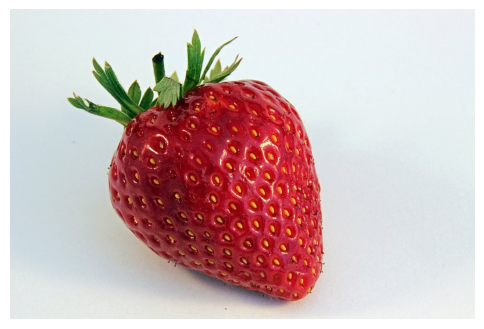

Processing index 7: https://as1.ftcdn.net/v2/jpg/02/10/59/70/1000_F_210597040_wxyvT8wGl322pfG6xO4LGW4FCWTgkOyX.jpg (True Label: Apple Pink Lady)

0: 608x640 1 apple, 8.7ms
Speed: 3.1ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
YOLO: apple (Confidence: 94.66%)
Classification: Apple Pink Lady 91.13%, Apple Red 2 6.91%
Match with true label (Apple Pink Lady): Yes


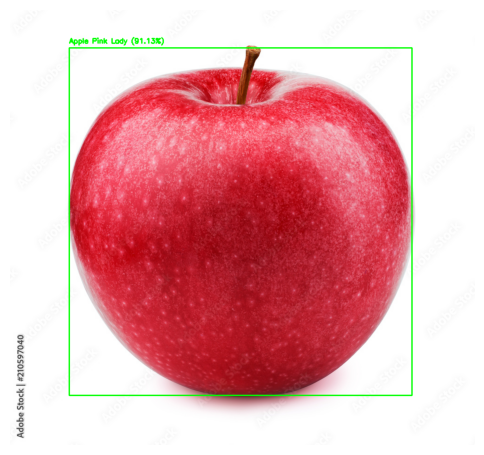

Processing index 8: https://img.freepik.com/premium-photo/onion-with-white-background-high-quality-ultra-hd_889056-8343.jpg (True Label: Onion Red Peeled)

0: 640x640 1 vase, 9.4ms
Speed: 3.4ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
YOLO: vase (Confidence: 82.72%)
Classification: Onion Red Peeled 100.00%, Peach Flat 0.00%
Match with true label (Onion Red Peeled): Yes


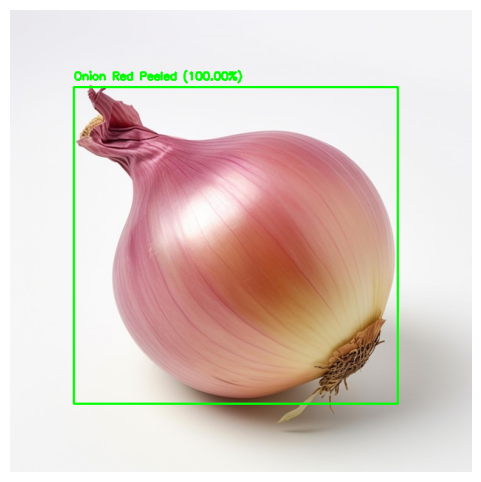

In [40]:
import cv2
import numpy as np
from ultralytics import YOLO
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import requests
from PIL import Image
from io import BytesIO

yolo_model = YOLO("yolov8s.pt")

classification_model = model

true_fruit_names = ["Raspberry", "Cantaloupe 1", "Limes", "Pear 2", "Corn", "Cucumber Ripe", "Strawberry Wedge", "Apple Pink Lady", "Onion Red Peeled"]

def preprocess_image(image, target_size):
    img = cv2.resize(image, target_size)
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=0)
    return img

def classify_region(image, model, class_names, target_size=(96, 96), top_k=2):
    input_image = preprocess_image(image, target_size)
    predictions = model.predict(input_image)[0]
    top_indices = predictions.argsort()[-top_k:][::-1]
    top_predictions = [(class_names[idx], predictions[idx]) for idx in top_indices]
    return top_predictions

def download_image(image_url):
    """
    Download an image from the given URL and return it as a NumPy array.
    """
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    return np.array(img)

def process_image_with_fallback(image_url, true_label, model, yolo_model, class_names, target_size=(96, 96)):
    """
    Download, detect objects with YOLO, classify detected regions, or fallback to entire image classification.
    """
    image = download_image(image_url)

    if image is None or image.size == 0:
        print(f"Error: The image from {image_url} could not be loaded!")
        return

    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    results = yolo_model(image_bgr)
    detections = results[0].boxes

    detected = False

    for box in detections:
        detected = True
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        conf = box.conf[0]
        cls_label = yolo_model.names[int(box.cls[0])]

        roi = image[y1:y2, x1:x2]

        if roi.shape[0] == 0 or roi.shape[1] == 0:
            continue

        predictions = classify_region(roi, model, class_names, target_size=target_size, top_k=2)
        label, confidence = predictions[0]
        second_label, second_confidence = predictions[1]

        is_match = label.lower() == true_label.lower()

        cv2.rectangle(image_bgr, (x1, y1), (x2, y2), (0, 255, 0), 2)
        text = f"{label} ({confidence:.2%})"
        cv2.putText(image_bgr, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        print(f"YOLO: {cls_label} (Confidence: {conf:.2%})")
        print(f"Classification: {label} {confidence:.2%}, {second_label} {second_confidence:.2%}")
        print(f"Match with true label ({true_label}): {'Yes' if is_match else 'No'}")

    if not detected:
        print("YOLO: -")
        predictions = classify_region(image, model, class_names, target_size=target_size, top_k=2)
        label, confidence = predictions[0]
        second_label, second_confidence = predictions[1]

        is_match = label.lower() == true_label.lower()

        print(f"Classification (entire image): {label} {confidence:.2%}, {second_label} {second_confidence:.2%}")
        print(f"Match with true label ({true_label}): {'Yes' if is_match else 'No'}")

    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 6))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.show()

image_urls = [
    "https://t4.ftcdn.net/jpg/05/35/26/95/360_F_535269565_W3ScF93L74MHNxgreu1KREMRwE2SHbOQ.jpg",
    "https://images.albertsons-media.com/is/image/ABS/184110201?$ng-ecom-pdp-mobile$&defaultImage=Not_Available",
    "https://media.istockphoto.com/id/177726303/photo/fresh-green-lime-isolated.jpg?s=612x612&w=0&k=20&c=KSIL64_zMFioesf2zZz7pF5GIm_lNLwdusJHoOf7a-0=",
    "https://amsterdam.co.nz/cdn/shop/products/pear.jpg?v=1620965886",
    "https://img.freepik.com/free-photo/fresh-corn_1339-506.jpg",
    "https://www.kroger.com/product/images/xlarge/back/0000000004062",
    "https://images.rawpixel.com/image_800/cHJpdmF0ZS9sci9pbWFnZXMvd2Vic2l0ZS8yMDIyLTA1L2Zyc3RyYXdiZXJyeV9yZWRfZGVsaWNpb3VzX3N3ZWV0LWltYWdlLWt5YmNtM3c3LmpwZw.jpg",
    "https://as1.ftcdn.net/v2/jpg/02/10/59/70/1000_F_210597040_wxyvT8wGl322pfG6xO4LGW4FCWTgkOyX.jpg",
    "https://img.freepik.com/premium-photo/onion-with-white-background-high-quality-ultra-hd_889056-8343.jpg"
    
]

for i, (image_url, true_label) in enumerate(zip(image_urls, true_fruit_names)):
    print(f"Processing index {i}: {image_url} (True Label: {true_label})")
    process_image_with_fallback(image_url, true_label, classification_model, yolo_model, class_names)

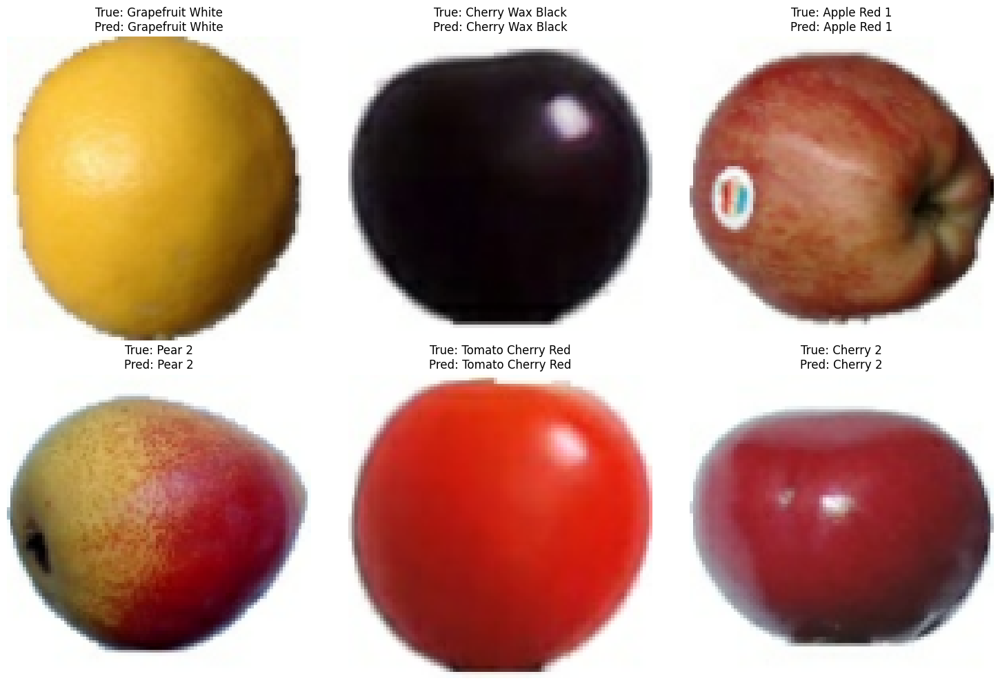

In [18]:
import matplotlib.pyplot as plt
import numpy as np

def display_test_predictions(test_dataset, model, class_names, num_images=6):
    for images, labels in test_dataset.take(1):  # Take one batch
        images, labels = images.numpy(), labels.numpy()
        break

    indices = np.random.choice(len(images), num_images, replace=False)

    plt.figure(figsize=(15, 10))
    for i, idx in enumerate(indices):
        image = images[idx]
        true_label = labels[idx]

        input_image = np.expand_dims(image, axis=0)
        prediction_probs = model.predict(input_image, verbose=0)
        predicted_label = np.argmax(prediction_probs)

        plt.subplot(2, 3, i + 1)
        plt.imshow(image)
        plt.title(f"True: {class_names[true_label]}\nPred: {class_names[predicted_label]}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

display_test_predictions(test_dataset, model, class_names, num_images=6)


In [19]:
import time
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten

mobilenet_base = MobileNetV2(weights='imagenet', include_top=False, input_shape=(96, 96, 3))

mobilenet_base.trainable = False

mobilenet_model = Sequential([
    mobilenet_base,
    Flatten(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(len(class_names), activation='softmax')
])

mobilenet_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [20]:
start_time = time.time()
mobilenet_history = mobilenet_model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=15
)
end_time = time.time()
mobilenet_training_time = end_time - start_time
print(f"Training time for 15 epochs: {mobilenet_training_time:.2f} seconds")

Epoch 1/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 31s 13ms/step - accuracy: 0.6684 - loss: 1.4070 - val_accuracy: 0.9939 - val_loss: 0.0201
Epoch 2/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9476 - loss: 0.1614 - val_accuracy: 0.9978 - val_loss: 0.0081
Epoch 3/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9558 - loss: 0.1429 - val_accuracy: 0.9990 - val_loss: 0.0041
Epoch 4/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9629 - loss: 0.1249 - val_accuracy: 0.9967 - val_loss: 0.0156
Epoch 5/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9693 - loss: 0.1146 - val_accuracy: 0.9993 - val_loss: 0.0021
Epoch 6/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9722 - loss: 0.1014 - val_accuracy: 0.9991 - val_loss: 0.0024
Epoch 7/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9718 - loss: 0.1130 - val_accuracy: 0.9997 - val_loss: 9.3367e-04
Epoch 8/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 15s 9ms/step - accuracy: 0.9767 - lo

In [21]:
test_loss, test_accuracy = mobilenet_model.evaluate(test_dataset)

print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

709/709 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.9661 - loss: 0.4650
Test Accuracy: 96.45%


In [22]:
mobilenet_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_96 (Functional)     │ (None, 3, 3, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 11520)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 11520)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │       1,474,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 131)                 │          16,899 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,732,747 (25.68 MB)

 Trainable params: 1,491,587 (5.69 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 2,983,176 (11.38 MB)

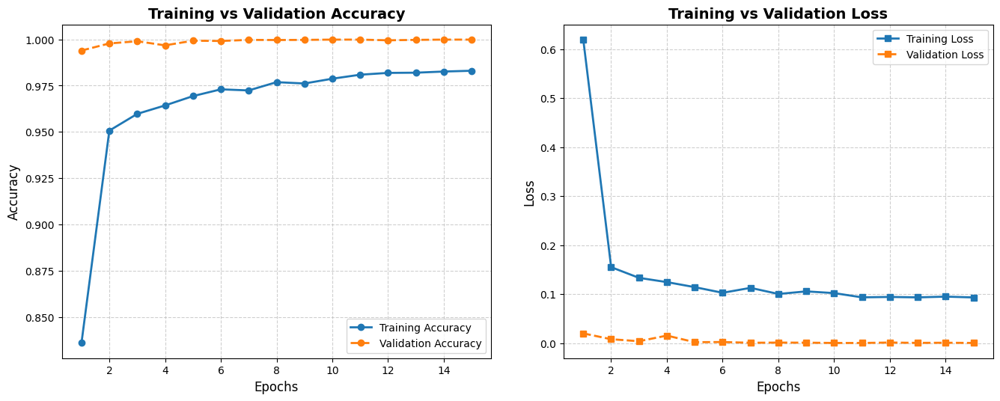

In [41]:
show_plot(mobilenet_history)

Processing index 0: https://t4.ftcdn.net/jpg/05/35/26/95/360_F_535269565_W3ScF93L74MHNxgreu1KREMRwE2SHbOQ.jpg (True Label: Raspberry)

0: 544x640 (no detections), 9.6ms
Speed: 2.4ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Classification (entire image): Raspberry 100.00%, Strawberry Wedge 0.00%
Match with true label (Raspberry): Yes


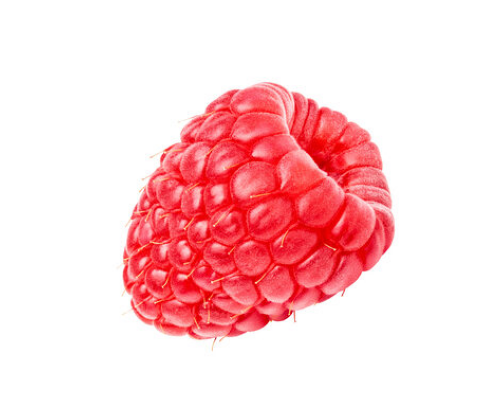

Processing index 1: https://images.albertsons-media.com/is/image/ABS/184110201?$ng-ecom-pdp-mobile$&defaultImage=Not_Available (True Label: Cantaloupe 1)

0: 640x640 (no detections), 9.4ms
Speed: 2.9ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Classification (entire image): Cantaloupe 2 100.00%, Pear Forelle 0.00%
Match with true label (Cantaloupe 1): No


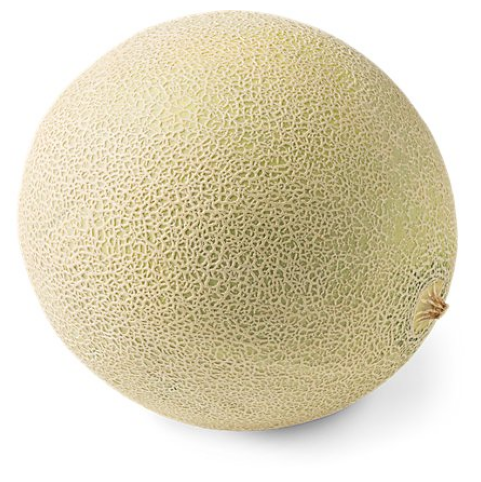

Processing index 2: https://media.istockphoto.com/id/177726303/photo/fresh-green-lime-isolated.jpg?s=612x612&w=0&k=20&c=KSIL64_zMFioesf2zZz7pF5GIm_lNLwdusJHoOf7a-0= (True Label: Limes)

0: 512x640 1 orange, 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
YOLO: orange (Confidence: 85.86%)
Classification: Limes 99.70%, Cantaloupe 1 0.30%
Match with true label (Limes): Yes


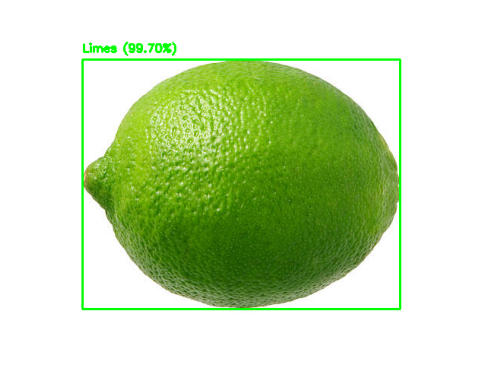

Processing index 3: https://amsterdam.co.nz/cdn/shop/products/pear.jpg?v=1620965886 (True Label: Pear 2)

0: 640x640 1 apple, 9.3ms
Speed: 3.0ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
YOLO: apple (Confidence: 37.94%)
Classification: Pear Red 75.21%, Pear 2 24.79%
Match with true label (Pear 2): No


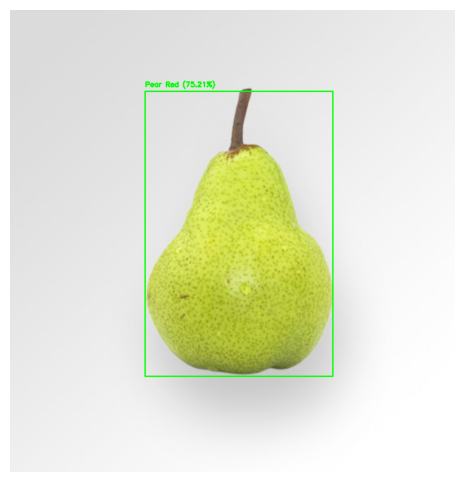

Processing index 4: https://img.freepik.com/free-photo/fresh-corn_1339-506.jpg (True Label: Corn)

0: 448x640 1 bowl, 7.5ms
Speed: 2.0ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
YOLO: bowl (Confidence: 47.73%)
Classification: Corn 100.00%, Cantaloupe 2 0.00%
Match with true label (Corn): Yes


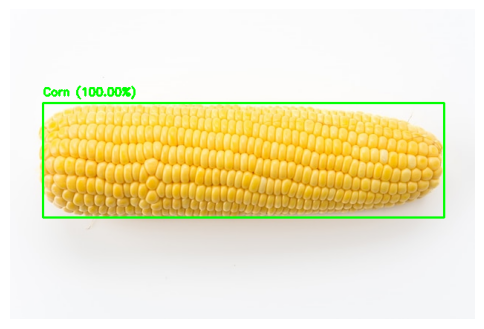

Processing index 5: https://www.kroger.com/product/images/xlarge/back/0000000004062 (True Label: Cucumber Ripe)

0: 416x640 1 knife, 7.9ms
Speed: 2.2ms preprocess, 7.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
YOLO: knife (Confidence: 51.22%)
Classification: Eggplant 100.00%, Banana 0.00%
Match with true label (Cucumber Ripe): No


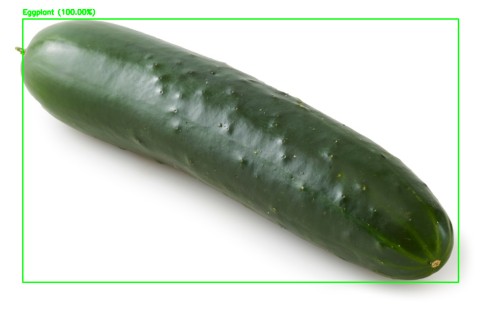

Processing index 6: https://images.rawpixel.com/image_800/cHJpdmF0ZS9sci9pbWFnZXMvd2Vic2l0ZS8yMDIyLTA1L2Zyc3RyYXdiZXJyeV9yZWRfZGVsaWNpb3VzX3N3ZWV0LWltYWdlLWt5YmNtM3c3LmpwZw.jpg (True Label: Strawberry Wedge)

0: 448x640 (no detections), 7.9ms
Speed: 2.1ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Classification (entire image): Cucumber Ripe 99.74%, Strawberry 0.26%
Match with true label (Strawberry Wedge): No


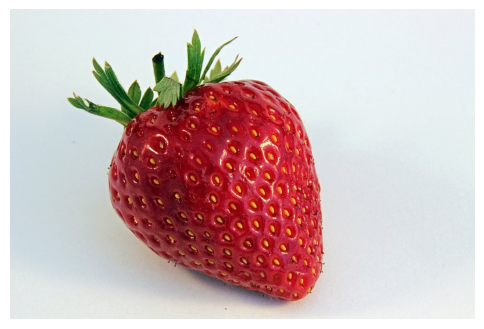

Processing index 7: https://as1.ftcdn.net/v2/jpg/02/10/59/70/1000_F_210597040_wxyvT8wGl322pfG6xO4LGW4FCWTgkOyX.jpg (True Label: Apple Pink Lady)

0: 608x640 1 apple, 8.6ms
Speed: 2.8ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
YOLO: apple (Confidence: 94.66%)
Classification: Pear Forelle 99.99%, Nectarine 0.01%
Match with true label (Apple Pink Lady): No


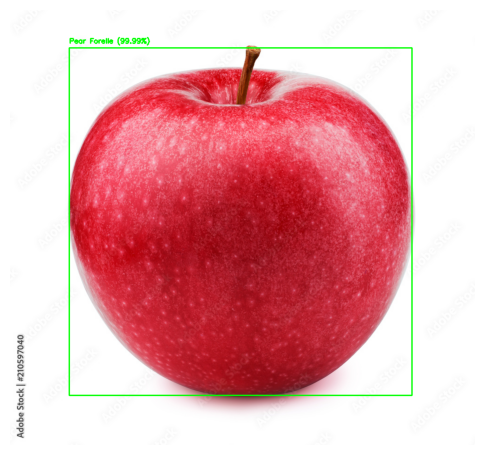

Processing index 8: https://img.freepik.com/premium-photo/onion-with-white-background-high-quality-ultra-hd_889056-8343.jpg (True Label: Onion Red Peeled)

0: 640x640 1 vase, 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
YOLO: vase (Confidence: 82.72%)
Classification: Onion Red Peeled 100.00%, Pear 2 0.00%
Match with true label (Onion Red Peeled): Yes


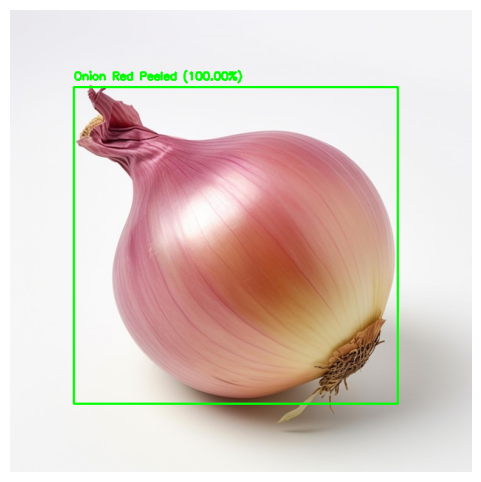

In [42]:
classification_model = mobilenet_model
for i, (image_url, true_label) in enumerate(zip(image_urls, true_fruit_names)):
    print(f"Processing index {i}: {image_url} (True Label: {true_label})")
    process_image_with_fallback(image_url, true_label, classification_model, yolo_model, class_names)

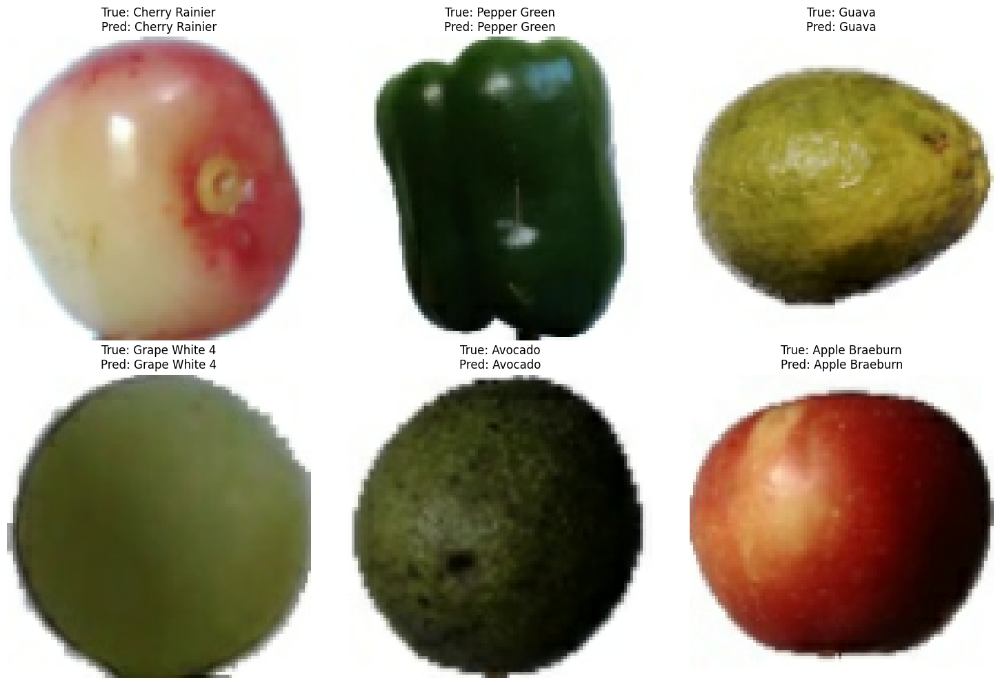

In [43]:
display_test_predictions(test_dataset, classification_model, class_names, num_images=6)

In [44]:
import time
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten

# Load the InceptionV3 base model
dense_base = DenseNet121(weights='imagenet', include_top=False, input_shape=(96, 96, 3))

# Freeze the base model layers
dense_base.trainable = False

# Build the full model
dense_model = Sequential([
    dense_base,
    Flatten(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(len(class_names), activation='softmax')
])

# Compile the model
dense_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [45]:
start_time = time.time()
dense_history = dense_model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=15
)
end_time = time.time()
dense_training_time = end_time - start_time
print(f"Training time for 15 epochs: {dense_training_time:.2f} seconds")

Epoch 1/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 83s 36ms/step - accuracy: 0.2758 - loss: 3.0775 - val_accuracy: 0.9050 - val_loss: 0.4268
Epoch 2/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 38s 22ms/step - accuracy: 0.6231 - loss: 1.2416 - val_accuracy: 0.9555 - val_loss: 0.1874
Epoch 3/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 37s 22ms/step - accuracy: 0.6808 - loss: 1.0252 - val_accuracy: 0.9668 - val_loss: 0.1243
Epoch 4/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 37s 22ms/step - accuracy: 0.7131 - loss: 0.9155 - val_accuracy: 0.9665 - val_loss: 0.1376
Epoch 5/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 38s 22ms/step - accuracy: 0.7307 - loss: 0.8677 - val_accuracy: 0.9766 - val_loss: 0.0956
Epoch 6/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 37s 22ms/step - accuracy: 0.7469 - loss: 0.8162 - val_accuracy: 0.9849 - val_loss: 0.0689
Epoch 7/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 37s 22ms/step - accuracy: 0.7556 - loss: 0.7765 - val_accuracy: 0.9840 - val_loss: 0.0574
Epoch 8/15
1693/1693 ━━━━━━━━━━━━━━━━━━━━ 37s 22ms/step - accuracy: 0.7653 -

In [46]:
test_loss, test_accuracy = dense_model.evaluate(test_dataset)

print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

709/709 ━━━━━━━━━━━━━━━━━━━━ 12s 18ms/step - accuracy: 0.9178 - loss: 0.3609
Test Accuracy: 91.67%


In [48]:
dense_model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ densenet121 (Functional)             │ (None, 3, 3, 1024)          │       7,037,504 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 9216)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 9216)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 128)                 │       1,179,776 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 131)                 │          16,899 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,627,531 (40.54 MB)

 Trainable params: 1,196,675 (4.56 MB)

 Non-trainable params: 7,037,504 (26.85 MB)

 Optimizer params: 2,393,352 (9.13 MB)

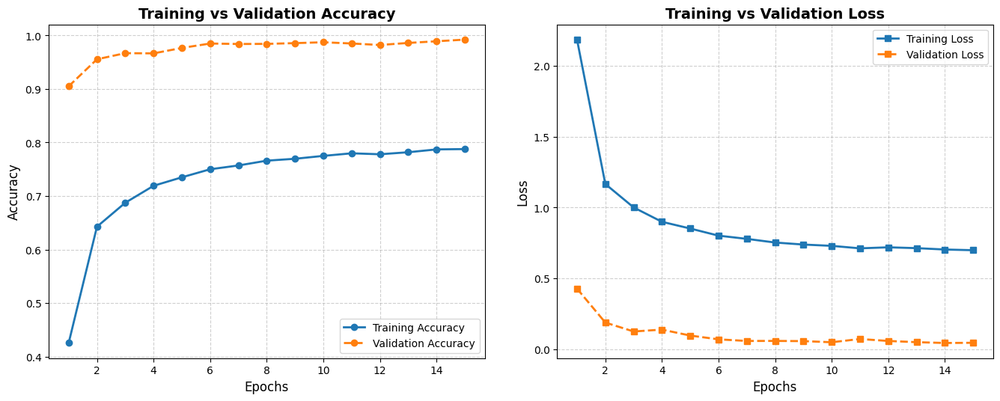

In [49]:
show_plot(dense_history)

Processing index 0: https://t4.ftcdn.net/jpg/05/35/26/95/360_F_535269565_W3ScF93L74MHNxgreu1KREMRwE2SHbOQ.jpg (True Label: Raspberry)

0: 544x640 (no detections), 10.5ms
Speed: 2.6ms preprocess, 10.5ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step
Classification (entire image): Raspberry 99.98%, Potato Red 0.01%
Match with true label (Raspberry): Yes


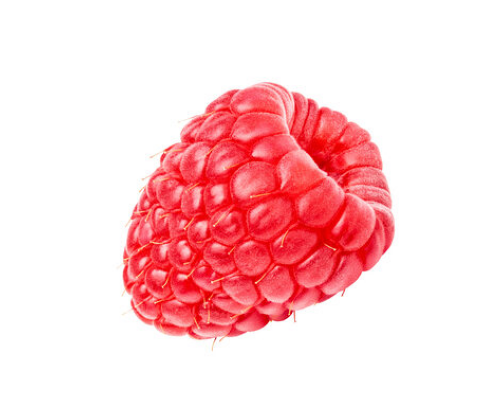

Processing index 1: https://images.albertsons-media.com/is/image/ABS/184110201?$ng-ecom-pdp-mobile$&defaultImage=Not_Available (True Label: Cantaloupe 1)

0: 640x640 (no detections), 8.6ms
Speed: 2.7ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Classification (entire image): Cantaloupe 2 99.49%, Grape White 4 0.51%
Match with true label (Cantaloupe 1): No


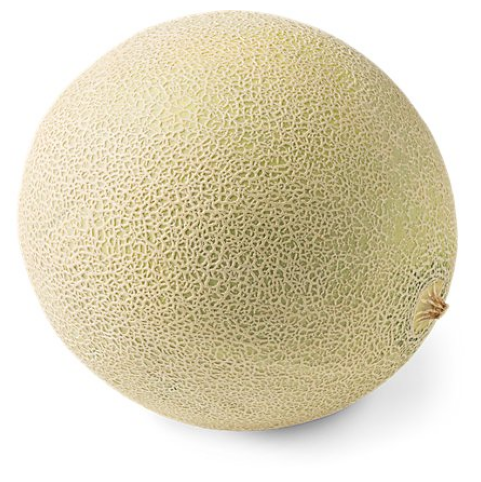

Processing index 2: https://media.istockphoto.com/id/177726303/photo/fresh-green-lime-isolated.jpg?s=612x612&w=0&k=20&c=KSIL64_zMFioesf2zZz7pF5GIm_lNLwdusJHoOf7a-0= (True Label: Limes)

0: 512x640 1 orange, 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
YOLO: orange (Confidence: 85.86%)
Classification: Mango 58.49%, Limes 32.64%
Match with true label (Limes): No


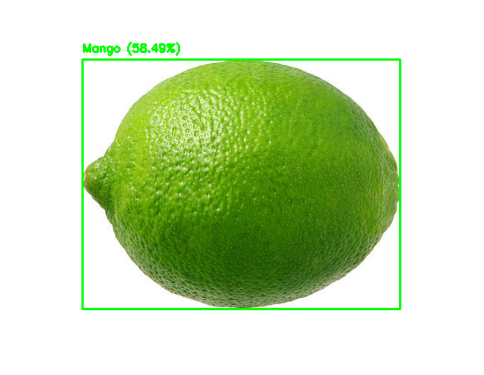

Processing index 3: https://amsterdam.co.nz/cdn/shop/products/pear.jpg?v=1620965886 (True Label: Pear 2)

0: 640x640 1 apple, 8.6ms
Speed: 3.2ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
YOLO: apple (Confidence: 37.94%)
Classification: Cantaloupe 1 100.00%, Cantaloupe 2 0.00%
Match with true label (Pear 2): No


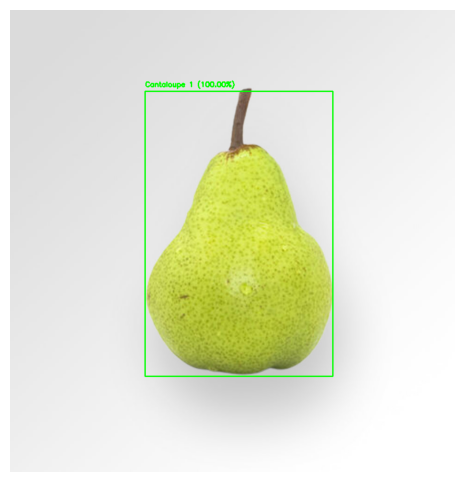

Processing index 4: https://img.freepik.com/free-photo/fresh-corn_1339-506.jpg (True Label: Corn)

0: 448x640 1 bowl, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
YOLO: bowl (Confidence: 47.73%)
Classification: Corn 99.40%, Physalis with Husk 0.54%
Match with true label (Corn): Yes


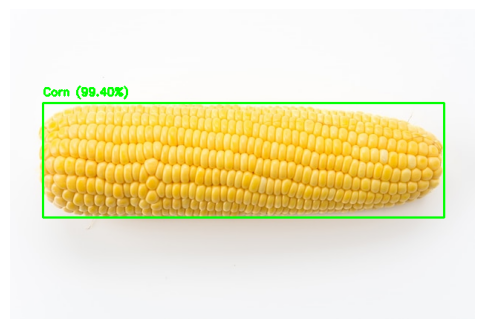

Processing index 5: https://www.kroger.com/product/images/xlarge/back/0000000004062 (True Label: Cucumber Ripe)

0: 416x640 1 knife, 9.5ms
Speed: 2.4ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
YOLO: knife (Confidence: 51.22%)
Classification: Corn Husk 87.01%, Potato Sweet 11.83%
Match with true label (Cucumber Ripe): No


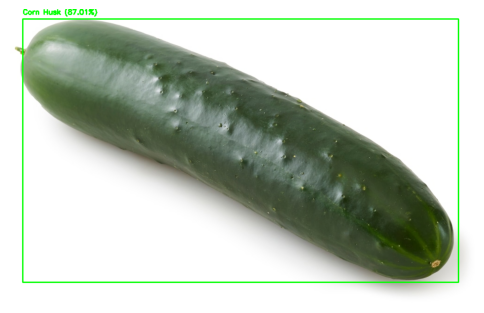

Processing index 6: https://images.rawpixel.com/image_800/cHJpdmF0ZS9sci9pbWFnZXMvd2Vic2l0ZS8yMDIyLTA1L2Zyc3RyYXdiZXJyeV9yZWRfZGVsaWNpb3VzX3N3ZWV0LWltYWdlLWt5YmNtM3c3LmpwZw.jpg (True Label: Strawberry Wedge)

0: 448x640 (no detections), 8.0ms
Speed: 2.1ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
YOLO: -
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Classification (entire image): Strawberry Wedge 99.14%, Avocado ripe 0.84%
Match with true label (Strawberry Wedge): Yes


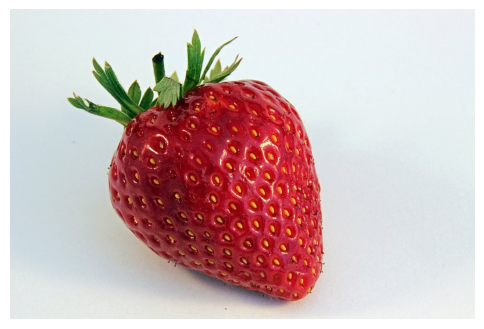

Processing index 7: https://as1.ftcdn.net/v2/jpg/02/10/59/70/1000_F_210597040_wxyvT8wGl322pfG6xO4LGW4FCWTgkOyX.jpg (True Label: Apple Pink Lady)

0: 608x640 1 apple, 9.6ms
Speed: 3.3ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
YOLO: apple (Confidence: 94.66%)
Classification: Pear Forelle 99.47%, Apple Pink Lady 0.29%
Match with true label (Apple Pink Lady): No


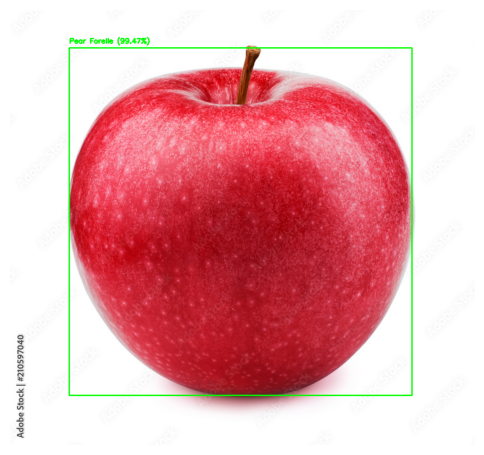

Processing index 8: https://img.freepik.com/premium-photo/onion-with-white-background-high-quality-ultra-hd_889056-8343.jpg (True Label: Onion Red Peeled)

0: 640x640 1 vase, 8.5ms
Speed: 2.7ms preprocess, 8.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
YOLO: vase (Confidence: 82.72%)
Classification: Tomato Cherry Red 64.58%, Tomato 4 29.45%
Match with true label (Onion Red Peeled): No


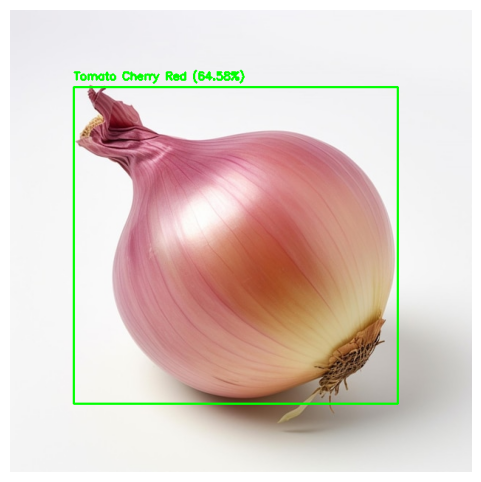

In [50]:
classification_model = dense_model
for i, (image_url, true_label) in enumerate(zip(image_urls, true_fruit_names)):
    print(f"Processing index {i}: {image_url} (True Label: {true_label})")
    process_image_with_fallback(image_url, true_label, classification_model, yolo_model, class_names)

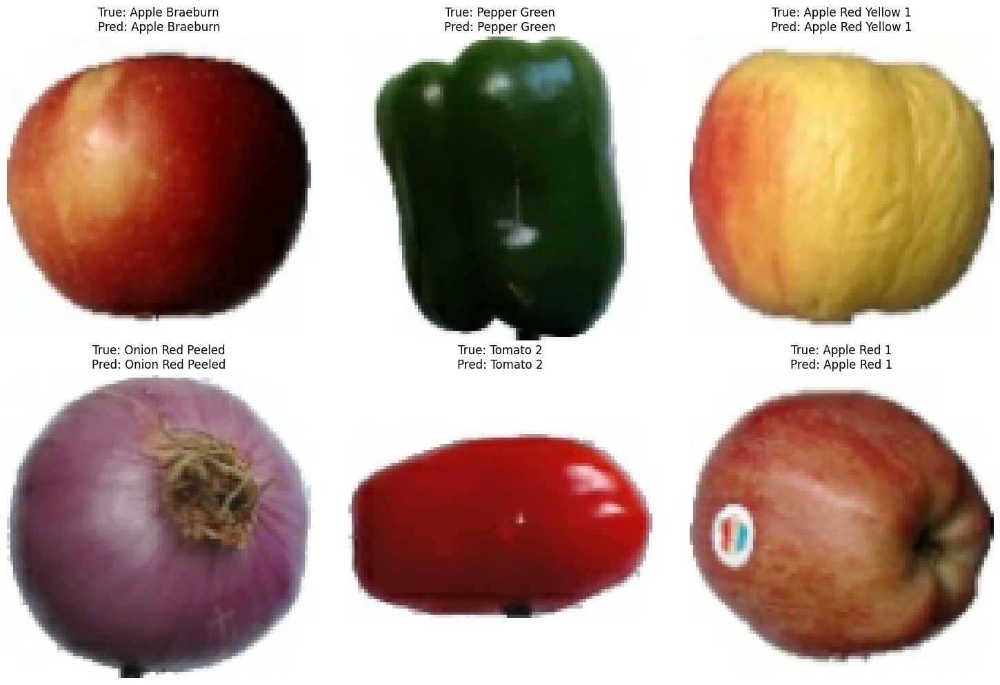

In [51]:
display_test_predictions(test_dataset, classification_model, class_names, num_images=6)

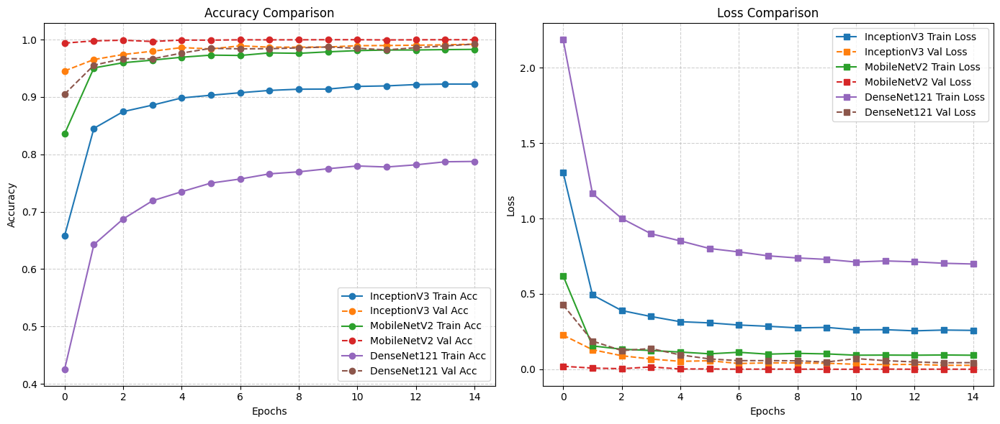

In [52]:
import matplotlib.pyplot as plt

def compare_training(histories, labels):
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    for history, label in zip(histories, labels):
        axs[0].plot(history.history['accuracy'], label=f"{label} Train Acc", marker='o')
        axs[0].plot(history.history['val_accuracy'], label=f"{label} Val Acc", linestyle='--', marker='o')
        
        axs[1].plot(history.history['loss'], label=f"{label} Train Loss", marker='s')
        axs[1].plot(history.history['val_loss'], label=f"{label} Val Loss", linestyle='--', marker='s')
    
    axs[0].set_title('Accuracy Comparison')
    axs[0].set_xlabel('Epochs')
    axs[0].set_ylabel('Accuracy')
    axs[0].legend()
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    axs[1].set_title('Loss Comparison')
    axs[1].set_xlabel('Epochs')
    axs[1].set_ylabel('Loss')
    axs[1].legend()
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout()
    plt.show()

histories = [history, mobilenet_history, dense_history]
labels = ['InceptionV3', 'MobileNetV2', 'DenseNet121']

compare_training(histories, labels)

In [2]:
import os

dataset_path = '/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2'

for root, dirs, files in os.walk(dataset_path):
    for name in dirs:
        print(f"Directory: {os.path.join(root, name)}")

Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Testing Data
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/TFRecords
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Training Data
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Validation Data
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Testing Data/Orchid
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Testing Data/Aster
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Testing Data/Lavender
Directory: /kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Testing Data/

In [3]:
import os

base_path = '/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2'

dataset_types = ['Training Data', 'Testing Data', 'Validation Data']

dataset_distribution = {}

for dataset_type in dataset_types:
    dataset_path = os.path.join(base_path, dataset_type)
    if os.path.exists(dataset_path):
        total_images = 0
        # Count the number of images in all categories
        for category in os.listdir(dataset_path):
            category_path = os.path.join(dataset_path, category)
            if os.path.isdir(category_path):
                total_images += len(os.listdir(category_path))
        dataset_distribution[dataset_type] = total_images
    else:
        dataset_distribution[dataset_type] = 0

total_images_all = sum(dataset_distribution.values())
percentage_distribution = {
    dataset_type: (count / total_images_all * 100) if total_images_all > 0 else 0
    for dataset_type, count in dataset_distribution.items()
}

print("\nImage Distribution Across Dataset Types:\n")
for dataset_type in dataset_types:
    print(f"{dataset_type}: {dataset_distribution[dataset_type]} images "
          f"({percentage_distribution[dataset_type]:.2f}%)")

print(f"\nTotal Images: {total_images_all}")



Image Distribution Across Dataset Types:

Training Data: 15000 images (67.10%)
Testing Data: 2355 images (10.53%)
Validation Data: 5000 images (22.37%)

Total Images: 22355


In [4]:
from PIL import Image

corrupted_images = []

def is_image_valid(image_path):
    try:
        with Image.open(image_path) as img:
            img.verify()
        return True
    except Exception:
        return False

for dataset_type in dataset_types:
    dataset_path = os.path.join(base_path, dataset_type)
    if os.path.exists(dataset_path):
        for category in os.listdir(dataset_path):
            category_path = os.path.join(dataset_path, category)
            if os.path.isdir(category_path):
                for image_file in os.listdir(category_path):
                    image_path = os.path.join(category_path, image_file)
                    if not is_image_valid(image_path):
                        corrupted_images.append(image_path)

if corrupted_images:
    print("\nCorrupted Images Found:")
    for corrupted_image in corrupted_images:
        print(corrupted_image)
else:
    print("\nAll images are valid. No corrupted files found.")



All images are valid. No corrupted files found.



Training Set Distribution:
Orchid: 1500
Aster: 1500
Lavender: 1500
Poppy: 1500
Marigold: 1500
Lily: 1500
Daisy: 1500
Sunflower: 1500
Rose: 1500
Iris: 1500


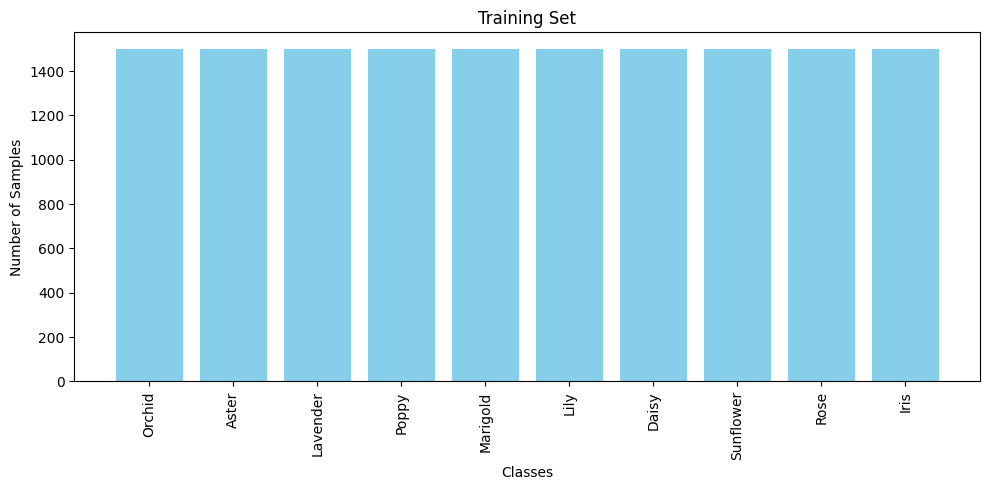


Validation Set Distribution:
Orchid: 500
Aster: 500
Lavender: 500
Poppy: 500
Marigold: 500
Lily: 500
Daisy: 500
Sunflower: 500
Rose: 500
Iris: 500


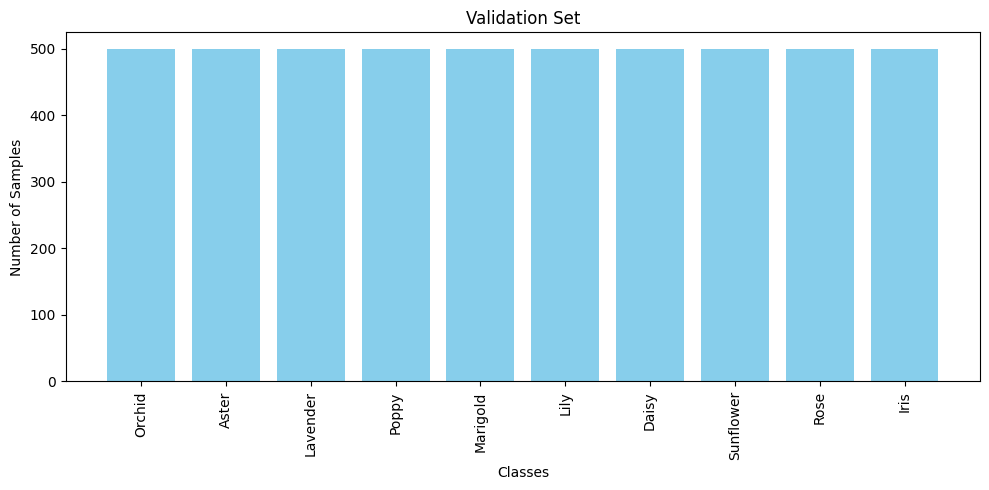


Testing Set Distribution:
Orchid: 202
Aster: 146
Lavender: 217
Poppy: 158
Marigold: 108
Lily: 350
Daisy: 260
Sunflower: 328
Rose: 269
Iris: 317


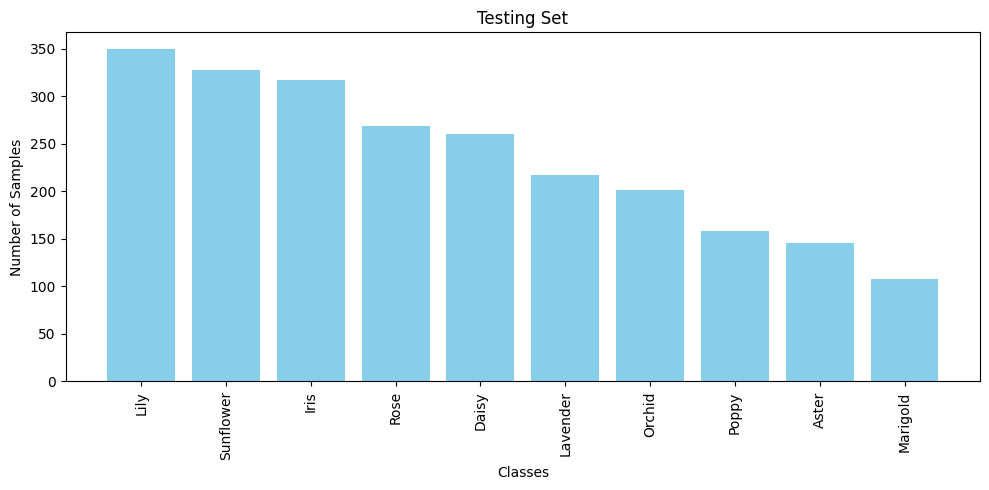

In [5]:
import os
import matplotlib.pyplot as plt

def calculate_class_distribution(directory):
    class_counts = {}
    for class_folder in os.listdir(directory):
        class_path = os.path.join(directory, class_folder)
        if os.path.isdir(class_path):
            num_images = len(os.listdir(class_path))
            class_counts[class_folder] = num_images
    return class_counts

def display_class_distribution(distribution, title):
    """Display class distribution as a bar chart."""
    print(f"\n{title} Distribution:")
    for cls, count in distribution.items():
        print(f"{cls}: {count}")

    sorted_distribution = sorted(distribution.items(), key=lambda x: x[1], reverse=True)
    classes, counts = zip(*sorted_distribution)

    plt.figure(figsize=(10, 5))
    plt.bar(classes, counts, color='skyblue')
    plt.title(title)
    plt.xlabel("Classes")
    plt.ylabel("Number of Samples")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()


base_dir = "/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2"
training_dir = os.path.join(base_dir, "Training Data")
validation_dir = os.path.join(base_dir, "Validation Data")
test_dir = os.path.join(base_dir, "Testing Data")

train_distribution = calculate_class_distribution(training_dir)
display_class_distribution(train_distribution, "Training Set")

validation_distribution = calculate_class_distribution(validation_dir)
display_class_distribution(validation_distribution, "Validation Set")

test_distribution = calculate_class_distribution(test_dir)
display_class_distribution(test_distribution, "Testing Set")

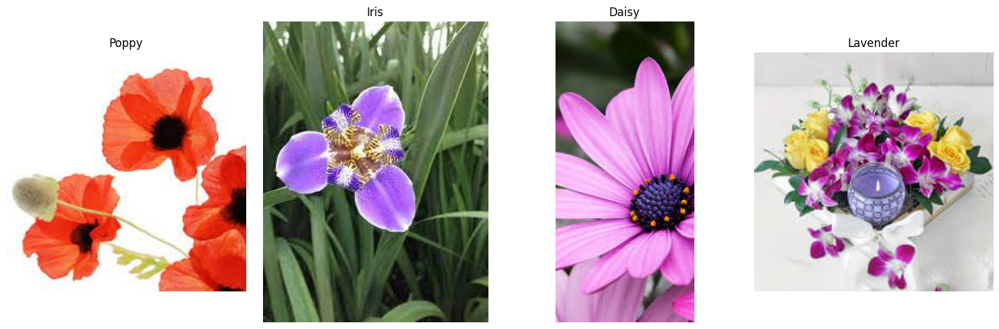

In [6]:
import matplotlib.pyplot as plt
import os
from PIL import Image
import random
import numpy as np

def load_random_samples(directory, num_samples=4):
    images = []
    labels = []
    class_indices = {class_name: idx for idx, class_name in enumerate(os.listdir(directory))}
    for _ in range(num_samples):
        class_name = random.choice(list(class_indices.keys()))
        class_path = os.path.join(directory, class_name)
        if os.path.isdir(class_path):
            image_name = random.choice(os.listdir(class_path))
            image_path = os.path.join(class_path, image_name)
            with Image.open(image_path) as img:
                images.append(np.array(img))
                labels.append(class_indices[class_name])
    return images, labels, class_indices

def visualize_samples(images, labels, class_indices, num_samples=4):
    class_names = {v: k for k, v in class_indices.items()}
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))

    for i in range(num_samples):
        axes[i].imshow(images[i])
        label_index = int(labels[i])
        class_name = class_names[label_index]
        axes[i].set_title(f"{class_name}")
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

training_dir = "/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Training Data"

images, labels, class_indices = load_random_samples(training_dir, num_samples=4)
visualize_samples(images, labels, class_indices, num_samples=4)

In [7]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def prepare_data(training_dir, validation_dir,test_dir, target_size=(160, 160), batch_size=32):
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    val_datagen = ImageDataGenerator(rescale=1./255)

    train_set = train_datagen.flow_from_directory(
        training_dir,
        target_size=target_size,
        batch_size=batch_size,
        class_mode='sparse'
    )

    validation_set = val_datagen.flow_from_directory(
        validation_dir,
        target_size=target_size,
        batch_size=batch_size,
        class_mode='sparse'
    )

    test_set = val_datagen.flow_from_directory(
        test_dir,
        target_size=target_size,
        batch_size=batch_size,
        class_mode='sparse'
    )
    return train_set, validation_set, test_set

In [8]:
base_dir = "/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2"
training_dir = f"{base_dir}/Training Data"
validation_dir = f"{base_dir}/Validation Data"

train_set, validation_set, test_set = prepare_data(training_dir, validation_dir, test_dir)

num_classes = train_set.num_classes

Found 15000 images belonging to 10 classes.
Found 5000 images belonging to 10 classes.
Found 2355 images belonging to 10 classes.


In [9]:
import time
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import layers, models, optimizers
import matplotlib.pyplot as plt

def build_model(base_model, num_classes):
    # for layer in base_model.layers[:-10]:
    #     layer.trainable = False

    model = models.Sequential()
    model.add(base_model)
    model.add(layers.Flatten())
    model.add(layers.Dense(128, activation='relu'))
    model.add(layers.Dropout(0.2))
    model.add(layers.Dense(256, activation='relu'))
    model.add(layers.Dense(num_classes, activation='softmax'))
    return model

def train_and_evaluate_model(model, train_set, validation_set, epochs=50, learning_rate=0.0001):
    model.compile(
        loss='sparse_categorical_crossentropy',
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
        metrics=['accuracy']
    )

    start_time = time.time()
    history = model.fit(
        train_set,
        epochs=epochs,
        validation_data=validation_set
    )
    end_time = time.time()

    training_time = end_time - start_time
    print(f"Training time for {epochs} epochs: {training_time:.2f} seconds")

    model.summary()
    show_plot(history)
    return history

def show_plot(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(acc) + 1)
    
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    axs[0].plot(epochs, acc, label='Training Accuracy', linewidth=2, marker='o')
    axs[0].plot(epochs, val_acc, label='Validation Accuracy', linewidth=2, marker='o', linestyle='--')
    axs[0].set_title('Training vs Validation Accuracy', fontsize=14, fontweight='bold')
    axs[0].set_xlabel('Epochs', fontsize=12)
    axs[0].set_ylabel('Accuracy', fontsize=12)
    axs[0].legend(loc='best', fontsize=10)
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    axs[1].plot(epochs, loss, label='Training Loss', linewidth=2, marker='s')
    axs[1].plot(epochs, val_loss, label='Validation Loss', linewidth=2, marker='s', linestyle='--')
    axs[1].set_title('Training vs Validation Loss', fontsize=14, fontweight='bold')
    axs[1].set_xlabel('Epochs', fontsize=12)
    axs[1].set_ylabel('Loss', fontsize=12)
    axs[1].legend(loc='best', fontsize=10)
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout(pad=3.0)
    plt.show()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


469/469 ━━━━━━━━━━━━━━━━━━━━ 201s 301ms/step - accuracy: 0.4735 - loss: 1.5509 - val_accuracy: 0.7776 - val_loss: 0.9726
Epoch 2/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 103s 216ms/step - accuracy: 0.7647 - loss: 0.7701 - val_accuracy: 0.8378 - val_loss: 0.7903
Epoch 3/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 103s 216ms/step - accuracy: 0.8152 - loss: 0.6284 - val_accuracy: 0.8440 - val_loss: 0.6246
Epoch 4/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 108s 227ms/step - accuracy: 0.8442 - loss: 0.5363 - val_accuracy: 0.8642 - val_loss: 0.5903
Epoch 5/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 107s 225ms/step - accuracy: 0.8609 - loss: 0.4656 - val_accuracy: 0.8628 - val_loss: 0.7191
Epoch 6/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 106s 222ms/step - accuracy: 0.8745 - loss: 0.4212 - val_accuracy: 0.8446 - val_loss: 1.4179
Epoch 7/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 121s 256ms/step - accuracy: 0.8781 - loss: 0.4183 - val_accuracy: 0.8654 - val_loss: 0.7650
Epoch 8/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 126s 264ms/step - accuracy: 0.8895 - loss: 0.37

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ inception_v3 (Functional)            │ (None, 3, 3, 2048)          │      21,802,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 18432)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       2,359,424 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │           2,570 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 48,361,174 (184.48 MB)

 Trainable params: 24,163,370 (92.18 MB)

 Non-trainable params: 34,432 (134.50 KB)

 Optimizer params: 24,163,372 (92.18 MB)

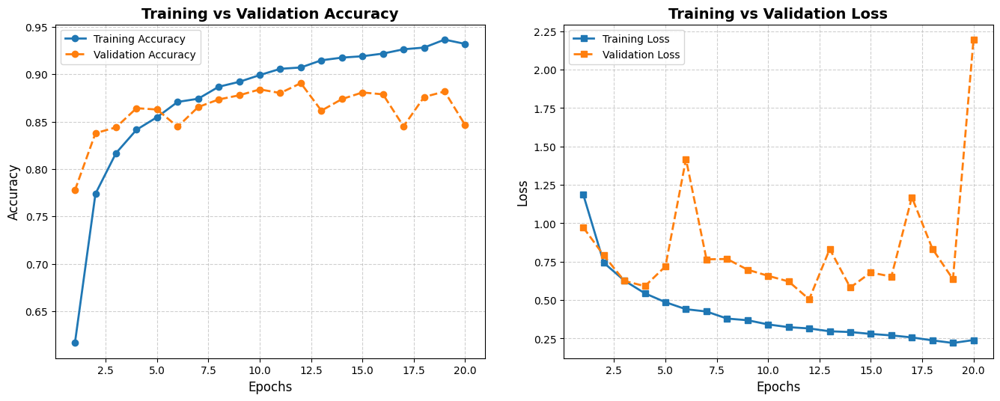

In [10]:
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(160, 160, 3))
model = build_model(base_model, num_classes)

inception_history = train_and_evaluate_model(model, train_set, validation_set, epochs=20)

In [11]:
def evaluate_model_on_test(model, test_set):
    test_loss, test_accuracy = model.evaluate(test_set)
    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {test_accuracy:.4f}")
    return test_loss, test_accuracy

In [12]:
evaluate_model_on_test(model, test_set)

74/74 ━━━━━━━━━━━━━━━━━━━━ 10s 142ms/step - accuracy: 0.8510 - loss: 1.6025
Test Loss: 1.6818
Test Accuracy: 0.8573


(1.6817762851715088, 0.8573248386383057)

In [13]:
import os

training_dir = "/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Training Data"

def get_species_list(dataset_dir):
    species = [folder for folder in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, folder))]
    species.sort()
    return species

species_list = get_species_list(training_dir)
print("Extracted Species List:", species_list)

Extracted Species List: ['Aster', 'Daisy', 'Iris', 'Lavender', 'Lily', 'Marigold', 'Orchid', 'Poppy', 'Rose', 'Sunflower']


Extracted Species List: ['Aster', 'Daisy', 'Iris', 'Lavender', 'Lily', 'Marigold', 'Orchid', 'Poppy', 'Rose', 'Sunflower']

0: 448x640 1 vase, 10.8ms
Speed: 2.0ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: https://static8.depositphotos.com/1003525/912/i/450/depositphotos_9123802-stock-photo-red-rose.jpg
YOLO Detection Confidence: 25.25%
Classification: Rose 99.91%, Poppy 0.07%
Expected flower: Rose
Match with true label (Rose): Yes


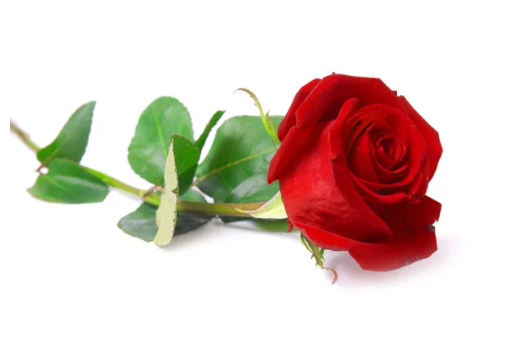


0: 448x640 1 bird, 7.0ms
Speed: 2.7ms preprocess, 7.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image: https://images.unsplash.com/photo-1501973931234-5ac2964cd94a?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8M3x8bGlseXxlbnwwfHwwfHx8MA%3D%3D
YOLO Detection Confidence: 52.15%
Classification: Lily 100.00%, Orchid 0.00%
Expected flower: Lily
Match with true label (Lily): Yes


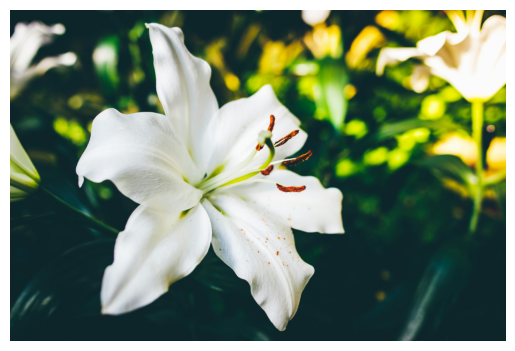


0: 576x640 1 potted plant, 8.6ms
Speed: 2.7ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Image: https://st.depositphotos.com/1307373/2537/i/450/depositphotos_25375695-stock-photo-purple-iris-flower.jpg
YOLO Detection Confidence: 29.46%
Classification: Iris 100.00%, Orchid 0.00%
Expected flower: Iris
Match with true label (Iris): Yes


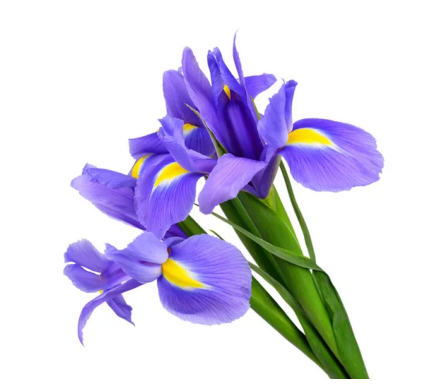


0: 448x640 1 potted plant, 7.5ms
Speed: 2.1ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image: https://media.istockphoto.com/id/1500727782/photo/lavender-flowers-with-green-leaves-isolated-on-a-white-background.jpg?s=612x612&w=0&k=20&c=BoXcI_lmL2ttr9kqz5HlNIBOSKfZsBzCEz7LgQIjVy0=
YOLO Detection Confidence: 44.74%
Classification: Lavender 96.58%, Iris 3.08%
Expected flower: Lavender
Match with true label (Lavender): Yes


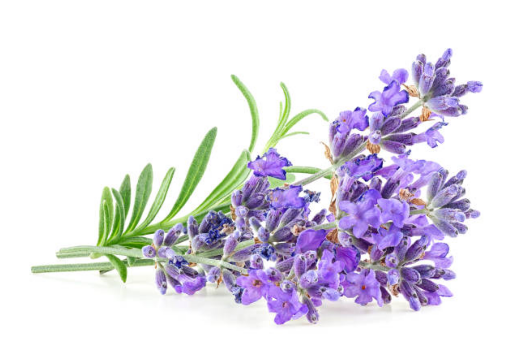


0: 448x640 1 potted plant, 7.2ms
Speed: 2.1ms preprocess, 7.2ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image: https://img.freepik.com/free-photo/ai-generated-sunflowers_23-2150681818.jpg
YOLO Detection Confidence: 31.20%
Classification: Sunflower 100.00%, Daisy 0.00%
Expected flower: Sunflower
Match with true label (Sunflower): Yes


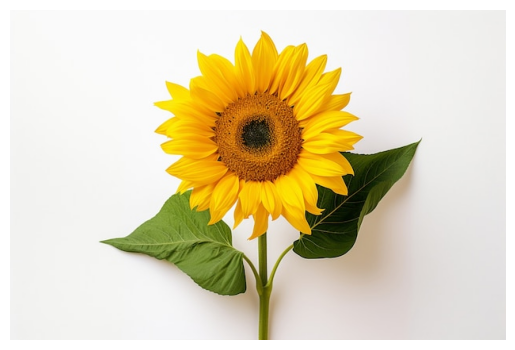

In [15]:
import cv2
import numpy as np
from ultralytics import YOLO
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import requests
from PIL import Image
from io import BytesIO
import os

training_dir = "/kaggle/input/flower-classification-5-classes-roselilyetc/Flower Classification V2/V2/Training Data"

def get_species_list(dataset_dir):
    species = [folder for folder in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, folder))]
    species.sort()
    return species

species_list = get_species_list(training_dir)
print("Extracted Species List:", species_list)

image_urls = [
    "https://static8.depositphotos.com/1003525/912/i/450/depositphotos_9123802-stock-photo-red-rose.jpg",
    "https://images.unsplash.com/photo-1501973931234-5ac2964cd94a?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8M3x8bGlseXxlbnwwfHwwfHx8MA%3D%3D",
    "https://st.depositphotos.com/1307373/2537/i/450/depositphotos_25375695-stock-photo-purple-iris-flower.jpg",
    "https://media.istockphoto.com/id/1500727782/photo/lavender-flowers-with-green-leaves-isolated-on-a-white-background.jpg?s=612x612&w=0&k=20&c=BoXcI_lmL2ttr9kqz5HlNIBOSKfZsBzCEz7LgQIjVy0=",
    "https://img.freepik.com/free-photo/ai-generated-sunflowers_23-2150681818.jpg"
]

true_flower_names = ["Rose", "Lily", "Iris", "Lavender", "Sunflower"]

yolo_model = YOLO("yolov8s.pt")

classification_model = model

def preprocess_image(image, target_size):
    img = cv2.resize(image, target_size)
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=0)
    return img

def classify_region(image, model, target_size=(160, 160), top_k=2):
    input_image = preprocess_image(image, target_size)
    predictions = model.predict(input_image)[0]
    top_indices = predictions.argsort()[-top_k:][::-1]
    top_predictions = [(species_list[idx], predictions[idx]) for idx in top_indices]
    return top_predictions

def download_image(image_url):
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    return np.array(img)

def process_image(image_url, true_flower_name, model, yolo_model, species_list):
    image = download_image(image_url)

    if image is None or image.size == 0:
        print(f"Error: The image from {image_url} could not be loaded!")
        return

    results = yolo_model(image)
    detections = results[0].boxes

    for detection in detections:
        x1, y1, x2, y2 = map(int, detection.xyxy[0].tolist())
        conf = float(detection.conf[0])
    
        roi = image[y1:y2, x1:x2]
    
        if roi.shape[0] > 0 and roi.shape[1] > 0:
            predictions = classify_region(roi, model, top_k=2)
            label, confidence = predictions[0]
            second_label, second_confidence = predictions[1]
    
            is_correct = label.lower() == true_flower_name.lower()
    
            print(f"Image: {image_url}")
            print(f"YOLO Detection Confidence: {conf * 100:.2f}%")
            print(f"Classification: {label} {confidence * 100:.2f}%, {second_label} {second_confidence * 100:.2f}%")
            print(f"Expected flower: {true_flower_name}")
            print(f"Match with true label ({true_flower_name}): {'Yes' if is_correct else 'No'}")
            break



    plt.imshow(image)
    plt.axis("off")
    plt.show()

for i, image_url in enumerate(image_urls):
    expected_flower = true_flower_names[i] if i < len(true_flower_names) else "Unknown"
    process_image(image_url, expected_flower, classification_model, yolo_model, species_list)

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 172s 294ms/step - accuracy: 0.5481 - loss: 1.3940 - val_accuracy: 0.7408 - val_loss: 1.0646
Epoch 2/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 102s 215ms/step - accuracy: 0.7837 - loss: 0.7065 - val_accuracy: 0.8212 - val_loss: 0.9324
Epoch 3/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 102s 214ms/step - accuracy: 0.8221 - loss: 0.5817 - val_accuracy: 0.8460 - val_loss: 0.8881
Epoch 4/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 103s 216ms/step - accuracy: 0.8440 - loss: 0.5091 - val_accuracy: 0.8502 - val_loss: 0.8290
Epoch 5/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 103s 216ms/step - accuracy: 0.8642 - loss: 0.4529 - val_accuracy: 0.8798 - val_loss: 0.6494
Epoch 6/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 106s 223ms/step - accuracy: 0.8720 - loss: 0.4156 - val_accuracy: 0.8414 - val_loss: 0.8395
Epoch 7/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 103s 217ms/step - accuracy: 0.8839 - loss: 0.3855 - val_accuracy: 0.8492 - val_loss: 0.8333
Epoch 8/20
469/469 ━━━━━━━━

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_160 (Functional)    │ (None, 5, 5, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 32000)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 128)                 │       4,096,128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 10)                  │           2,570 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 12,745,302 (48.62 MB)

 Trainable params: 6,355,594 (24.24 MB)

 Non-trainable params: 34,112 (133.25 KB)

 Optimizer params: 6,355,596 (24.24 MB)

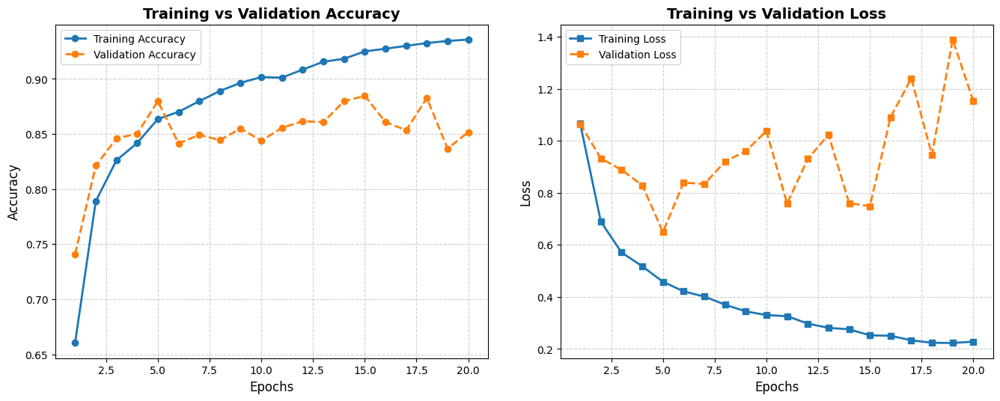

In [16]:
from tensorflow.keras.applications import MobileNetV2

mobilenet_base = MobileNetV2(weights='imagenet', include_top=False, input_shape=(160, 160, 3))
mobilenet_model = build_model(mobilenet_base, num_classes)
mobilenet_history = train_and_evaluate_model(mobilenet_model, train_set, validation_set, epochs=20)

In [17]:
evaluate_model_on_test(mobilenet_model, test_set)

74/74 ━━━━━━━━━━━━━━━━━━━━ 8s 113ms/step - accuracy: 0.8418 - loss: 1.2578
Test Loss: 1.2778
Test Accuracy: 0.8450


(1.277819037437439, 0.8450106382369995)


0: 448x640 1 vase, 11.1ms
Speed: 2.9ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Image: https://static8.depositphotos.com/1003525/912/i/450/depositphotos_9123802-stock-photo-red-rose.jpg
YOLO Detection Confidence: 25.25%
Classification: Rose 98.13%, Orchid 1.85%
Expected flower: Rose
Match with true label (Rose): Yes


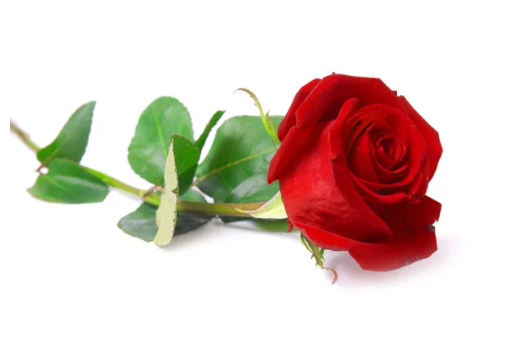


0: 448x640 1 bird, 7.2ms
Speed: 2.8ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image: https://images.unsplash.com/photo-1501973931234-5ac2964cd94a?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8M3x8bGlseXxlbnwwfHwwfHx8MA%3D%3D
YOLO Detection Confidence: 52.15%
Classification: Lily 100.00%, Orchid 0.00%
Expected flower: Lily
Match with true label (Lily): Yes


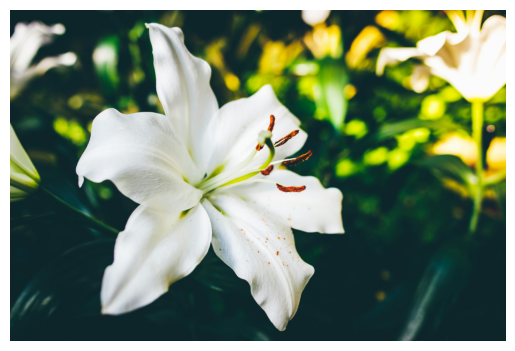


0: 576x640 1 potted plant, 8.1ms
Speed: 2.5ms preprocess, 8.1ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: https://st.depositphotos.com/1307373/2537/i/450/depositphotos_25375695-stock-photo-purple-iris-flower.jpg
YOLO Detection Confidence: 29.46%
Classification: Iris 100.00%, Lily 0.00%
Expected flower: Iris
Match with true label (Iris): Yes


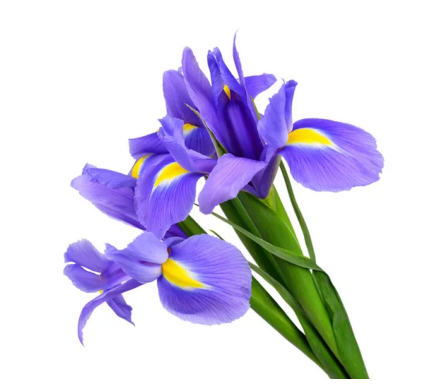


0: 448x640 1 potted plant, 7.8ms
Speed: 2.2ms preprocess, 7.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Image: https://media.istockphoto.com/id/1500727782/photo/lavender-flowers-with-green-leaves-isolated-on-a-white-background.jpg?s=612x612&w=0&k=20&c=BoXcI_lmL2ttr9kqz5HlNIBOSKfZsBzCEz7LgQIjVy0=
YOLO Detection Confidence: 44.74%
Classification: Iris 90.26%, Lavender 9.73%
Expected flower: Lavender
Match with true label (Lavender): No


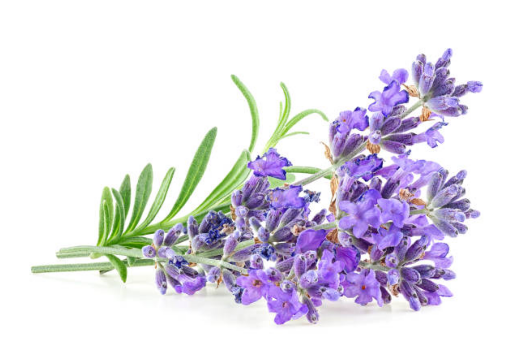


0: 448x640 1 potted plant, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: https://img.freepik.com/free-photo/ai-generated-sunflowers_23-2150681818.jpg
YOLO Detection Confidence: 31.20%
Classification: Sunflower 100.00%, Daisy 0.00%
Expected flower: Sunflower
Match with true label (Sunflower): Yes


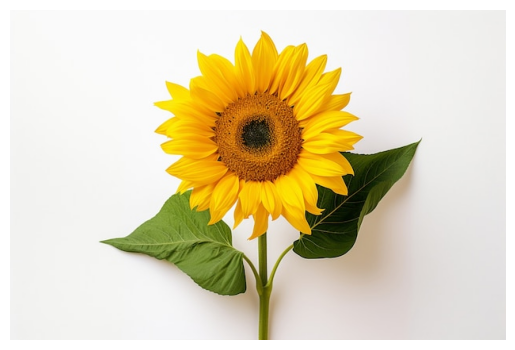

In [18]:
classification_model = mobilenet_model
for i, image_url in enumerate(image_urls):
    expected_flower = true_flower_names[i] if i < len(true_flower_names) else "Unknown"
    process_image(image_url, expected_flower, classification_model, yolo_model, species_list)

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 311s 428ms/step - accuracy: 0.5894 - loss: 1.2676 - val_accuracy: 0.8236 - val_loss: 0.7422
Epoch 2/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 109s 228ms/step - accuracy: 0.8193 - loss: 0.6090 - val_accuracy: 0.8744 - val_loss: 0.5301
Epoch 3/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 108s 226ms/step - accuracy: 0.8535 - loss: 0.4987 - val_accuracy: 0.8778 - val_loss: 0.5952
Epoch 4/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 108s 227ms/step - accuracy: 0.8688 - loss: 0.4326 - val_accuracy: 0.8864 - val_loss: 0.5979
Epoch 5/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 107s 225ms/step - accuracy: 0.8862 - loss: 0.3922 - val_accuracy: 0.8684 - val_loss: 0.8239
Epoch 6/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 108s 227ms/step - accuracy: 0.8931 - loss: 0.3542 - val_accuracy: 0.8926 - val_loss: 0.5834
Epoch 7/20
469/469 ━━━━━━━━━━━━━━━━━━━━ 109s 228ms/step - accuracy: 0.9022 - loss: 0.3240 - val_accuracy: 0.8920 - val_loss: 0.5936
Epoch 8/20
469/469 ━━━━━━

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ densenet121 (Functional)             │ (None, 5, 5, 1024)          │       7,037,504 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 25600)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 128)                 │       3,276,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 256)                 │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │           2,570 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,616,406 (78.65 MB)

 Trainable params: 10,266,378 (39.16 MB)

 Non-trainable params: 83,648 (326.75 KB)

 Optimizer params: 10,266,380 (39.16 MB)

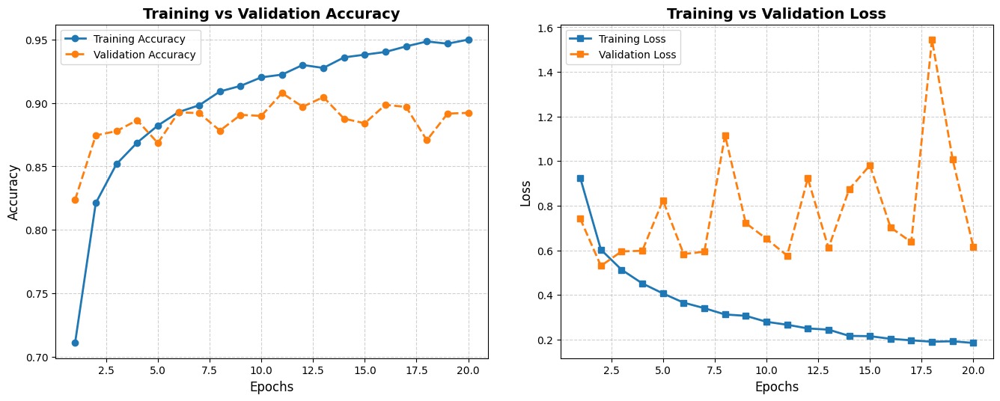

In [19]:
from tensorflow.keras.applications import DenseNet121

dense_base = DenseNet121(weights='imagenet', include_top=False, input_shape=(160, 160, 3))
dense_model = build_model(dense_base, num_classes)
dense_history = train_and_evaluate_model(dense_model, train_set, validation_set, epochs=20)

In [20]:
evaluate_model_on_test(dense_model, test_set)

74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 196ms/step - accuracy: 0.8734 - loss: 0.7491
Test Loss: 0.8102
Test Accuracy: 0.8675


(0.8101561665534973, 0.8675159215927124)


0: 448x640 1 vase, 10.9ms
Speed: 3.2ms preprocess, 10.9ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step
Image: https://static8.depositphotos.com/1003525/912/i/450/depositphotos_9123802-stock-photo-red-rose.jpg
YOLO Detection Confidence: 25.25%
Classification: Rose 50.15%, Poppy 42.88%
Expected flower: Rose
Match with true label (Rose): Yes


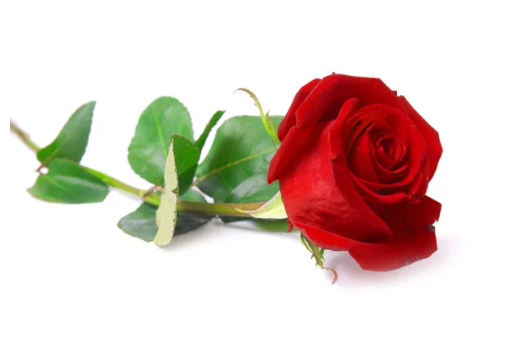


0: 448x640 1 bird, 7.2ms
Speed: 2.7ms preprocess, 7.2ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Image: https://images.unsplash.com/photo-1501973931234-5ac2964cd94a?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8M3x8bGlseXxlbnwwfHwwfHx8MA%3D%3D
YOLO Detection Confidence: 52.15%
Classification: Lily 100.00%, Iris 0.00%
Expected flower: Lily
Match with true label (Lily): Yes


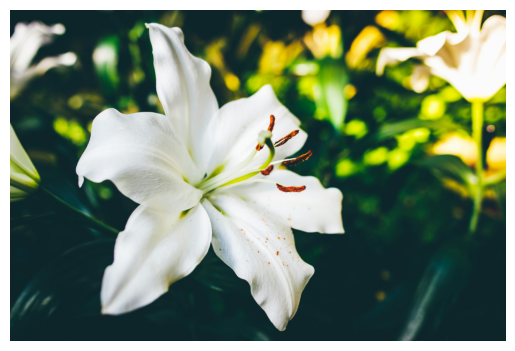


0: 576x640 1 potted plant, 7.8ms
Speed: 2.5ms preprocess, 7.8ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image: https://st.depositphotos.com/1307373/2537/i/450/depositphotos_25375695-stock-photo-purple-iris-flower.jpg
YOLO Detection Confidence: 29.46%
Classification: Iris 100.00%, Lavender 0.00%
Expected flower: Iris
Match with true label (Iris): Yes


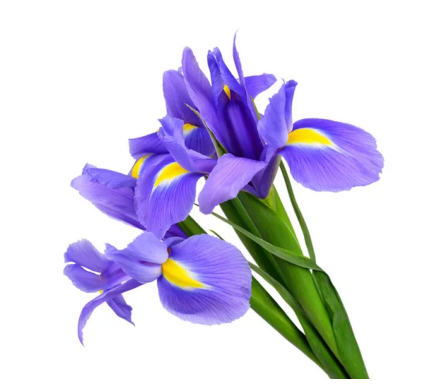


0: 448x640 1 potted plant, 8.6ms
Speed: 2.5ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Image: https://media.istockphoto.com/id/1500727782/photo/lavender-flowers-with-green-leaves-isolated-on-a-white-background.jpg?s=612x612&w=0&k=20&c=BoXcI_lmL2ttr9kqz5HlNIBOSKfZsBzCEz7LgQIjVy0=
YOLO Detection Confidence: 44.74%
Classification: Iris 99.33%, Lavender 0.65%
Expected flower: Lavender
Match with true label (Lavender): No


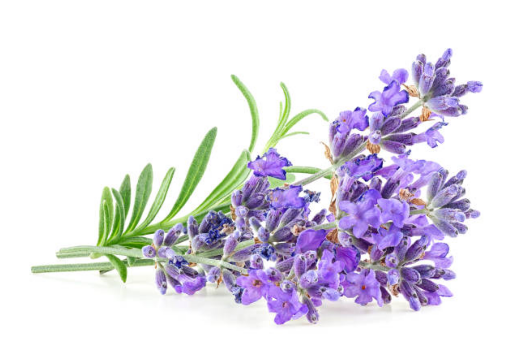


0: 448x640 1 potted plant, 7.3ms
Speed: 2.2ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Image: https://img.freepik.com/free-photo/ai-generated-sunflowers_23-2150681818.jpg
YOLO Detection Confidence: 31.20%
Classification: Sunflower 100.00%, Marigold 0.00%
Expected flower: Sunflower
Match with true label (Sunflower): Yes


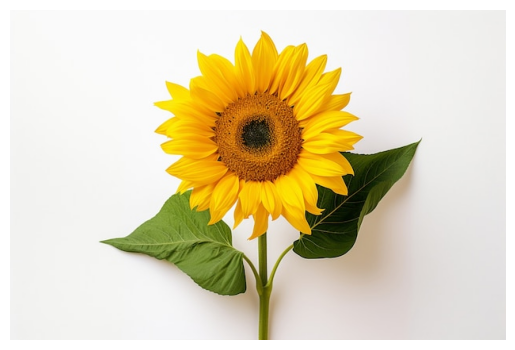

In [21]:
classification_model = dense_model
for i, image_url in enumerate(image_urls):
    expected_flower = true_flower_names[i] if i < len(true_flower_names) else "Unknown"
    process_image(image_url, expected_flower, classification_model, yolo_model, species_list)

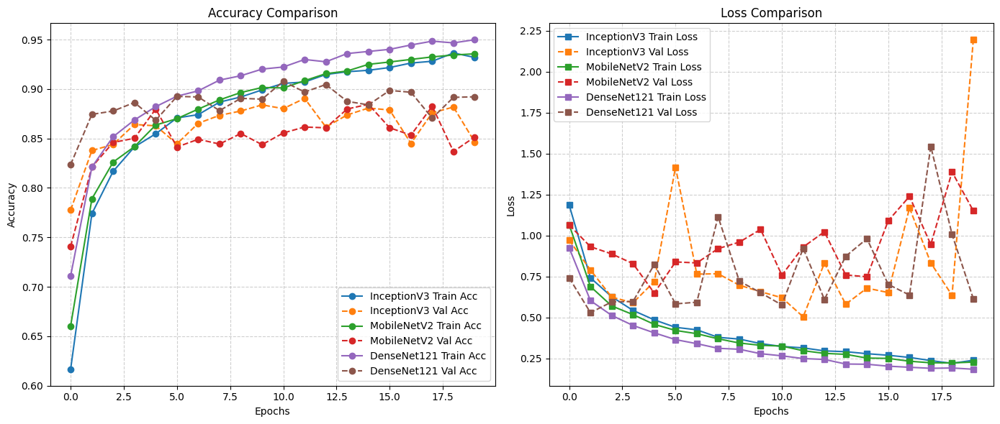

In [23]:
import matplotlib.pyplot as plt

def compare_training(histories, labels):
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    
    for history, label in zip(histories, labels):
        axs[0].plot(history.history['accuracy'], label=f"{label} Train Acc", marker='o')
        axs[0].plot(history.history['val_accuracy'], label=f"{label} Val Acc", linestyle='--', marker='o')
        
        axs[1].plot(history.history['loss'], label=f"{label} Train Loss", marker='s')
        axs[1].plot(history.history['val_loss'], label=f"{label} Val Loss", linestyle='--', marker='s')
    
    axs[0].set_title('Accuracy Comparison')
    axs[0].set_xlabel('Epochs')
    axs[0].set_ylabel('Accuracy')
    axs[0].legend()
    axs[0].grid(visible=True, linestyle='--', alpha=0.6)
    
    axs[1].set_title('Loss Comparison')
    axs[1].set_xlabel('Epochs')
    axs[1].set_ylabel('Loss')
    axs[1].legend()
    axs[1].grid(visible=True, linestyle='--', alpha=0.6)
    
    plt.tight_layout()
    plt.show()

histories = [inception_history, mobilenet_history, dense_history]
labels = ['InceptionV3', 'MobileNetV2', 'DenseNet121']

compare_training(histories, labels)